___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___

<h1 style="text-align: center;">Deep Learning<br><br>Session - 3<br><br>Regression with ANN (Dummy Version for Month)<br><br>KC House Data<br><h1>

# Keras Regression

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show")

plt.rcParams["figure.figsize"] = (10,6)

sns.set_style("whitegrid")
pd.set_option('display.float_format', lambda x: '%.3f' % x)

# Set it None to display all rows in the dataframe
# pd.set_option('display.max_rows', None)

# Set it to None to display all columns in the dataframe
pd.set_option('display.max_columns', None)

In [2]:
!pip install folium 
# harita kullanmak adına install ediyoruz.

In [5]:
#from google.colab import drive
#drive.mount('/content/drive')

In [6]:
#df = pd.read_csv("drive/MyDrive/Colab_Files/data/kc_house_data.csv")

In [7]:
#from matplotlib import style
#style.use('dark_background')

In [3]:
df = pd.read_csv("kc_house_data.csv")

## Exploratory Data Analysis and Visualization

In [4]:
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.000,3,1.000,1180,5650,1.000,0,0,3,7,1180,0,1955,0,98178,47.511,-122.257,1340,5650
1,6414100192,12/9/2014,538000.000,3,2.250,2570,7242,2.000,0,0,3,7,2170,400,1951,1991,98125,47.721,-122.319,1690,7639
2,5631500400,2/25/2015,180000.000,2,1.000,770,10000,1.000,0,0,3,6,770,0,1933,0,98028,47.738,-122.233,2720,8062
3,2487200875,12/9/2014,604000.000,4,3.000,1960,5000,1.000,0,0,5,7,1050,910,1965,0,98136,47.521,-122.393,1360,5000
4,1954400510,2/18/2015,510000.000,3,2.000,1680,8080,1.000,0,0,3,8,1680,0,1987,0,98074,47.617,-122.045,1800,7503


We will be using data from a Kaggle data set:

https://www.kaggle.com/harlfoxem/housesalesprediction

#### Feature Columns : Data daki futurelerin açıklamaları.
    
* id - Unique ID for each home sold
* date - Date of the home sale
* price - Price of each home sold
* bedrooms - Number of bedrooms
* bathrooms - Number of bathrooms, where .5 accounts for a room with a toilet but no shower
* sqft_living - Square footage of the apartments interior living space
* sqft_lot - Square footage of the land space
* floors - Number of floors
* waterfront - A dummy variable for whether the apartment was overlooking the waterfront or not
* view - An index from 0 to 4 of how good the view of the property was
* condition - An index from 1 to 5 on the condition of the apartment,
* grade - An index from 1 to 13, where 1-3 falls short of building construction and design, 7 has an average level of construction and design, and 11-13 have a high quality level of construction and design.
* sqft_above - The square footage of the interior housing space that is above ground level
* sqft_basement - The square footage of the interior housing space that is below ground level
* yr_built - The year the house was initially built
* yr_renovated - The year of the house’s last renovation
* zipcode - What zipcode area the house is in
* lat - Lattitude
* long - Longitude
* sqft_living15 - The square footage of interior housing living space for the nearest 15 neighbors
* sqft_lot15 - The square footage of the land lots of the nearest 15 neighbors

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     21597 non-null  int64  
 9   view           21597 non-null  int64  
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  int64  
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   21597 non-null  int64  
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

In [6]:
df.isnull().sum().any()

False

In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,21597.000,4580474287.771,2876735715.748,1000102.000,2123049175.000,3904930410.000,7308900490.000,9900000190.000
price,21597.000,540296.574,367368.140,78000.000,322000.000,450000.000,645000.000,7700000.000
bedrooms,21597.000,3.373,0.926,1.000,3.000,3.000,4.000,33.000
bathrooms,21597.000,2.116,0.769,0.500,1.750,2.250,2.500,8.000
sqft_living,21597.000,2080.322,918.106,370.000,1430.000,1910.000,2550.000,13540.000
sqft_lot,21597.000,15099.409,41412.637,520.000,5040.000,7618.000,10685.000,1651359.000
floors,21597.000,1.494,0.540,1.000,1.000,1.500,2.000,3.500
waterfront,21597.000,0.008,0.087,0.000,0.000,0.000,0.000,1.000
view,21597.000,0.234,0.766,0.000,0.000,0.000,0.000,4.000
condition,21597.000,3.410,0.651,1.000,3.000,3.000,4.000,5.000


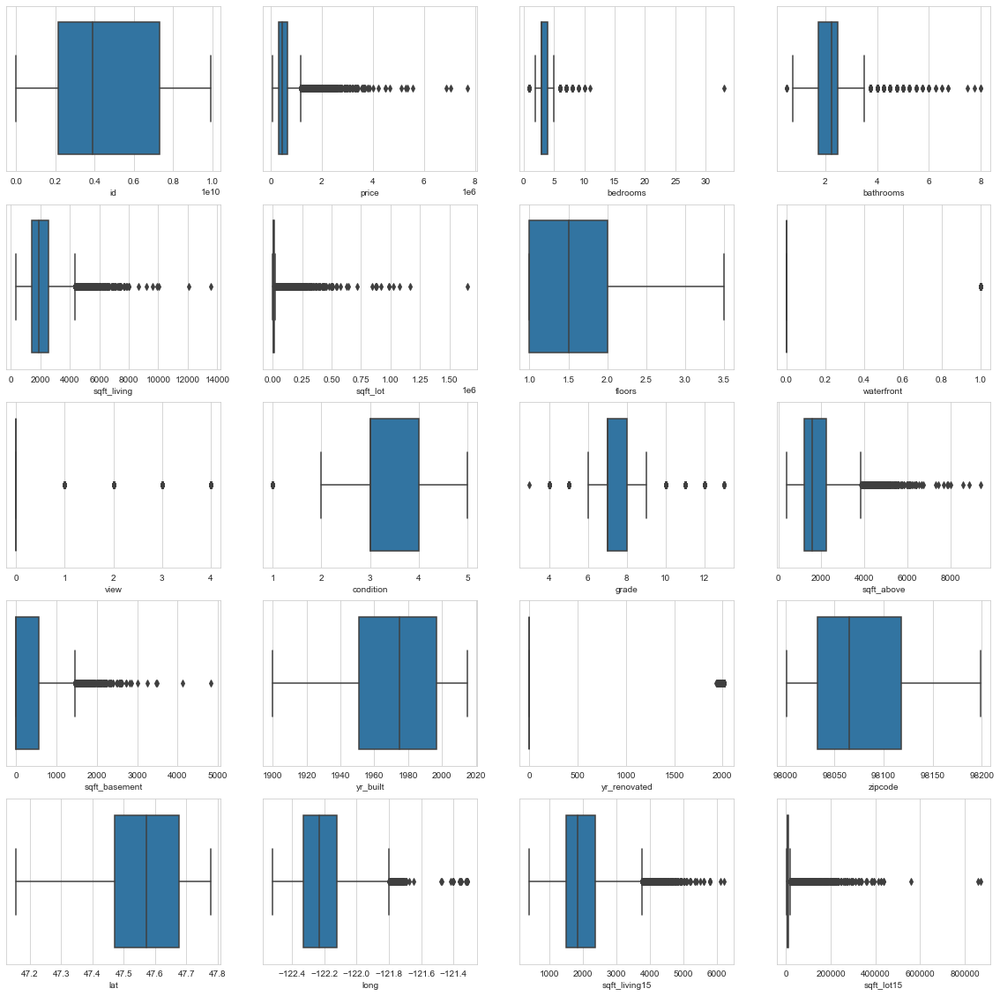

In [8]:
index = 0
plt.figure(figsize=(20,20))
for i in df.select_dtypes([float, int]).columns:
    index += 1
    plt.subplot(5,4,index)
    sns.boxplot(df.select_dtypes([float, int])[i], whis=1.6)

### İd_number

In [9]:
df = df.drop('id', axis = 1)
# id numarası modelleme için işe yaramamaktadır o yüzden sildik.

### price

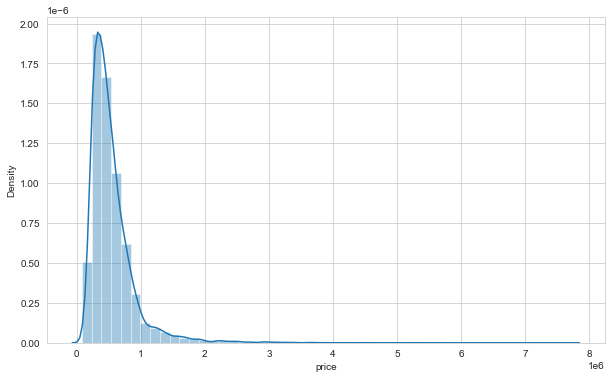

In [10]:
sns.distplot(df['price']);
# burda ağırlıklı olarak 500 ile 2000 arasında değerler toplanmış. 3 binden sonrası biraz outlier gibi

In [11]:
# 3 milyondan büyük evlere bakalım. diğer futuere verilerine bakalım.
df[df["price"] > 3000000].sort_values(by="price", ascending=False)

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
7245,10/13/2014,7700000.000,6,8.000,12050,27600,2.500,0,3,4,13,8570,3480,1910,1987,98102,47.630,-122.323,3940,8800
3910,6/11/2014,7060000.000,5,4.500,10040,37325,2.000,1,2,3,11,7680,2360,1940,2001,98004,47.650,-122.214,3930,25449
9245,9/19/2014,6890000.000,6,7.750,9890,31374,2.000,0,4,3,13,8860,1030,2001,0,98039,47.630,-122.240,4540,42730
4407,8/4/2014,5570000.000,5,5.750,9200,35069,2.000,0,0,3,13,6200,3000,2001,0,98039,47.629,-122.233,3560,24345
1446,4/13/2015,5350000.000,5,5.000,8000,23985,2.000,0,4,3,12,6720,1280,2009,0,98004,47.623,-122.220,4600,21750
1313,4/13/2015,5300000.000,6,6.000,7390,24829,2.000,1,4,4,12,5000,2390,1991,0,98040,47.563,-122.210,4320,24619
1162,10/20/2014,5110000.000,5,5.250,8010,45517,2.000,1,4,3,12,5990,2020,1999,0,98033,47.677,-122.211,3430,26788
8085,6/17/2014,4670000.000,5,6.750,9640,13068,1.000,1,4,3,12,4820,4820,1983,2009,98040,47.557,-122.210,3270,10454
2624,8/15/2014,4500000.000,5,5.500,6640,40014,2.000,1,4,3,12,6350,290,2004,0,98155,47.749,-122.280,3030,23408
8629,6/18/2014,4490000.000,4,3.000,6430,27517,2.000,0,0,3,12,6430,0,2001,0,98004,47.621,-122.219,3720,14592


In [12]:
df.groupby("waterfront").mean().T
# deniz kenarında bulunan evlerin fiyat ortalamasının denize kıyısı olamayan evlerden aha yüksek olduğu görüldü.

waterfront,0,1
price,531762.324,1662524.184
bedrooms,3.374,3.301
bathrooms,2.112,2.678
sqft_living,2072.007,3173.687
sqft_lot,15021.290,25371.828
floors,1.493,1.641
view,0.207,3.767
condition,3.409,3.534
grade,7.649,8.773
sqft_above,1783.392,2473.043


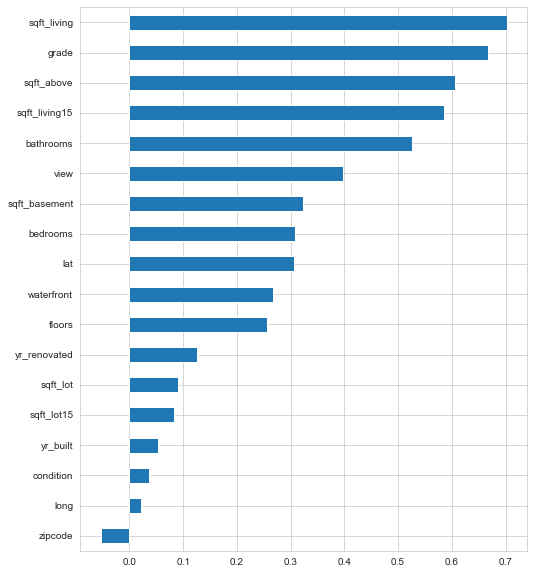

In [13]:
plt.figure(figsize = (8,10))
df.corr()["price"].sort_values().drop("price").plot(kind = "barh");
# fiyatları en çok etkileyen sutunlara baktık.

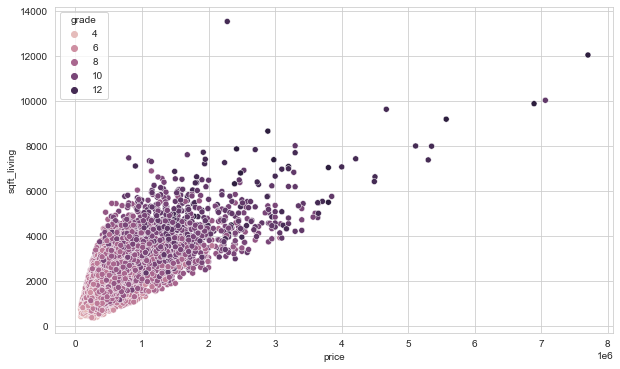

In [14]:
sns.scatterplot(x = 'price',y = 'sqft_living', data = df, hue = "grade");
# evin metrekaresi ile fiyat arasında pozitif bir korelasyon olduğunu bulduk.

In [15]:
df['sqft_living'].corr(df["price"])

0.7019173021377595

### bedrooms

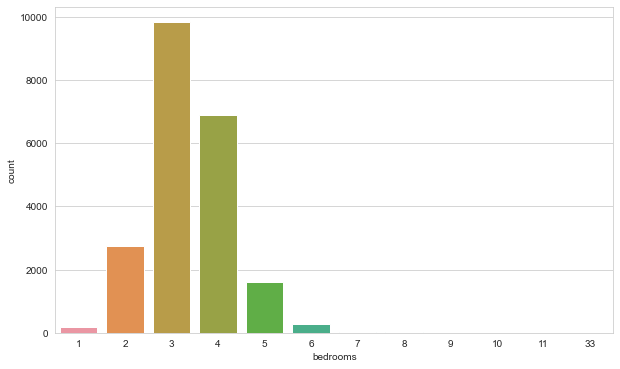

In [16]:
sns.countplot(df['bedrooms']);
# yatak odası sayılarını gösterdik.

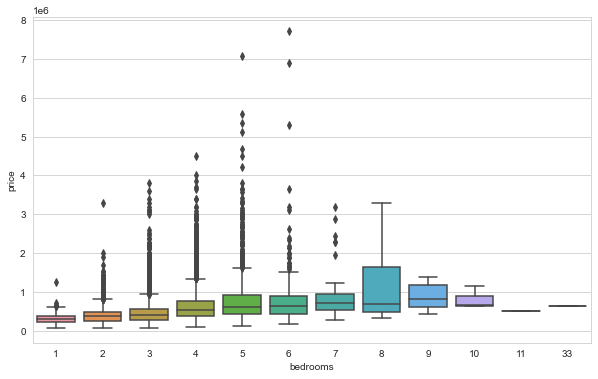

In [17]:
sns.boxplot(x = 'bedrooms', y = 'price', data = df);
# fiyat ile odaların boxplotlarına baktık.

In [18]:
df["bedrooms"].corr(df["price"])
# aralarında pozitif korelasyon var.

0.30878747195653283

In [19]:
df[df["bedrooms"] > 10]
# 11 odalı evde 1 tane banyo olmaz. bathrooms = 1.750 

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
8748,8/21/2014,520000.000,11,3.000,3000,4960,2.000,0,0,3,7,2400,600,1918,1999,98106,47.556,-122.363,1420,4960
15856,6/25/2014,640000.000,33,1.750,1620,6000,1.000,0,0,5,7,1040,580,1947,0,98103,47.688,-122.331,1330,4700


In [20]:
df.iloc[15856, 3] = 3.0

In [21]:
df.iloc[15856, 3]

3.0

Most likely the data was entered incorrectly.

In [22]:
df.shape

(21597, 20)

### date

In [23]:
df['date'].dtype
# tarih sutunumuzun tipi object, biz bunu numeric tipine çevirelim.

dtype('O')

In [24]:
df['date'] = pd.to_datetime(df['date'])
# datetime tipine çevirdik.

In [25]:
df['date'].head()

0   2014-10-13
1   2014-12-09
2   2015-02-25
3   2014-12-09
4   2015-02-18
Name: date, dtype: datetime64[ns]

In [26]:
df['year'] = df['date'].dt.year
#df['year'] = df['date'].apply(lambda date : date.year)
# year adlı bir sutun oluşturup sadece yılını aldık burda.

In [27]:
df["year"].head(3)

0    2014
1    2014
2    2015
Name: year, dtype: int64

In [28]:
df['month'] = df['date'].dt.month
# ay adlı bir sutun oluşturup sadece ayları aldık.

In [29]:
df[["year", "month"]].head()

,year,month
0,2014,10
1,2014,12
2,2015,2
3,2014,12
4,2015,2


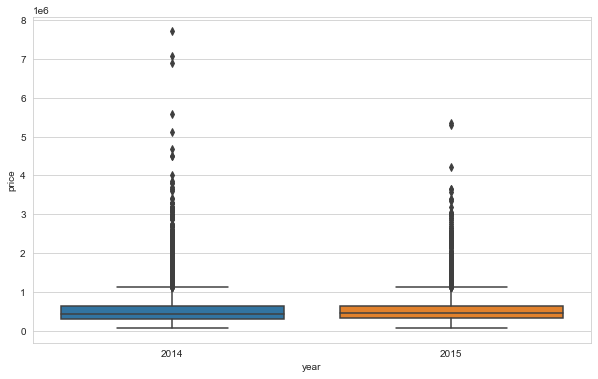

In [30]:
sns.boxplot(x = 'year', y = 'price', data = df);

In [31]:
df.groupby("year")["price"].mean().T
# 2015 yılında ki evlerin fiyatları biraz daha yükselmiş.

year
2014   539350.912
2015   542279.006
Name: price, dtype: float64

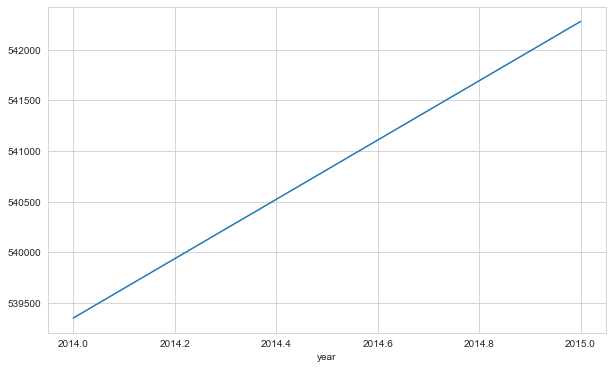

In [32]:
df.groupby('year')['price'].mean().plot();

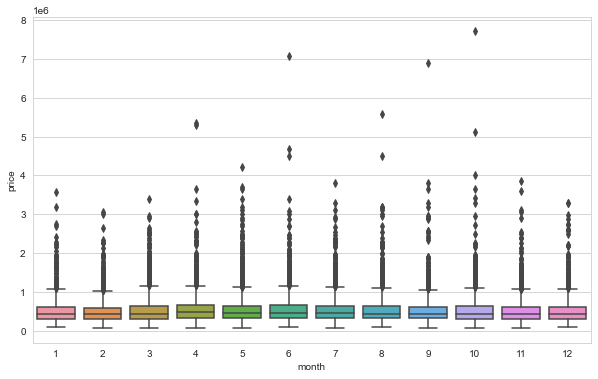

In [33]:
sns.boxplot(x = 'month', y = 'price', data = df);

In [34]:
df.groupby("month")["price"].mean().sort_values(ascending=False)
# en yüksek fiyatlar genelde 4,5,6,7. aylarda artmış.

month
4    562215.615
6    557534.318
5    550849.747
7    544892.161
3    544057.683
10   539439.447
8    536655.212
9    529723.518
1    525963.252
12   524799.902
11   522359.903
2    508520.051
Name: price, dtype: float64

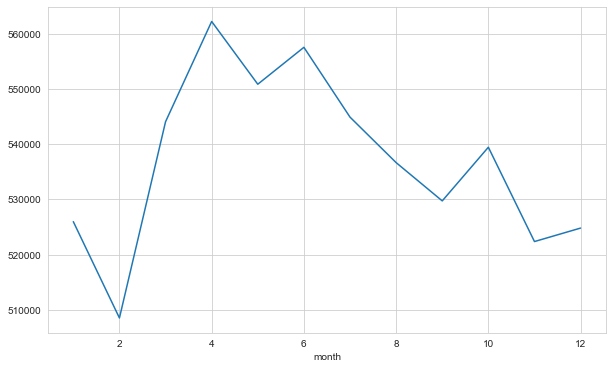

In [35]:
df.groupby('month')['price'].mean().plot();

In [36]:
month_dummy = pd.get_dummies(df["month"], prefix = "month")
# ayların birbirlerine karşı bir üstünlükleri yo onun için getdummy yaptık.

In [37]:
df = pd.concat([df, month_dummy], axis = 1)
df.head()

,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,month,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
0,2014-10-13,221900.000,3,1.000,1180,5650,1.000,0,0,3,7,1180,0,1955,0,98178,47.511,-122.257,1340,5650,2014,10,0,0,0,0,0,0,0,0,0,1,0,0
1,2014-12-09,538000.000,3,2.250,2570,7242,2.000,0,0,3,7,2170,400,1951,1991,98125,47.721,-122.319,1690,7639,2014,12,0,0,0,0,0,0,0,0,0,0,0,1
2,2015-02-25,180000.000,2,1.000,770,10000,1.000,0,0,3,6,770,0,1933,0,98028,47.738,-122.233,2720,8062,2015,2,0,1,0,0,0,0,0,0,0,0,0,0
3,2014-12-09,604000.000,4,3.000,1960,5000,1.000,0,0,5,7,1050,910,1965,0,98136,47.521,-122.393,1360,5000,2014,12,0,0,0,0,0,0,0,0,0,0,0,1
4,2015-02-18,510000.000,3,2.000,1680,8080,1.000,0,0,3,8,1680,0,1987,0,98074,47.617,-122.045,1800,7503,2015,2,0,1,0,0,0,0,0,0,0,0,0,0


In [38]:
df = df.drop(['date', "year", "month"], axis = 1)
# dummy yaptıktan sonra sildik.

### zipcode

In [39]:
df['zipcode'].value_counts(dropna = False)
# evlerin bulundukları mahallelerin posta kodları.

98103    602
98038    589
98115    583
98052    574
98117    553
        ... 
98102    104
98010    100
98024     80
98148     57
98039     50
Name: zipcode, Length: 70, dtype: int64

we can categorize the zipcodes as north, south, west, east, middle by regions. But it can be made manually and taken many time and we need domain knowladge to do that. So we will drop this column.

In [40]:
df = df.drop('zipcode', axis = 1)

### yr_renovated & yr_built

In [41]:
df['yr_renovated'].value_counts(dropna = False)
# evlerin tamirat tarihleri. 0 yazanlar tamir edilmeyen. 2014 yılında 91 ev tamirat yapılmış.

0       20683
2014       91
2013       37
2003       36
2005       35
        ...  
1951        1
1959        1
1948        1
1954        1
1944        1
Name: yr_renovated, Length: 70, dtype: int64

In [42]:
df['yr_built'].value_counts(dropna = False)
# evlerin inşaat tarihleri. en çok ev yapılan yıl 2014 yılı.

2014    559
2006    453
2005    450
2004    433
2003    420
       ... 
1933     30
1901     29
1902     27
1935     24
1934     21
Name: yr_built, Length: 116, dtype: int64

could make sense due to scaling, higher should correlate to more value

In [43]:
# df["yr_renovated"].replace(0, np.nan, inplace = True)
# df["yr_renovated"].fillna(df["yr_built"], inplace = True)
# df.drop("yr_built", axis = 1, inplace = True)

In [44]:
# df["yr_renovated"].replace(0, np.nan, inplace = True)
# df["yr_renovated"].fillna(df["yr_built"], inplace = True)
# df["new_age"] = 2021 - df["yr_renovated"]
# df.drop(["yr_renovated", "yr_built"], axis = 1, inplace = True)

### sqft_basement

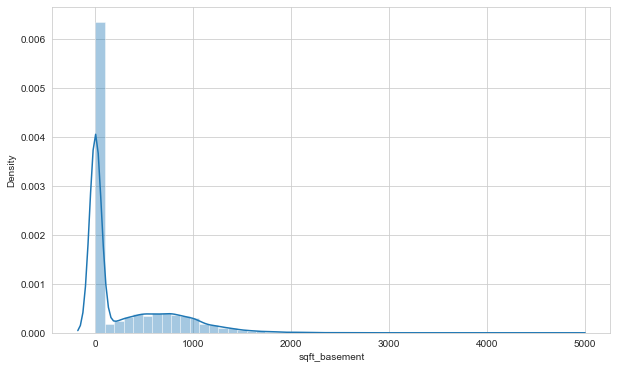

In [45]:
sns.distplot(df['sqft_basement']);
# bodrum katların yüzölçümleri genelde 0 ve 1000 metrekare arasında

In [46]:
df['sqft_basement'].value_counts(dropna = False)

0      13110
600      221
700      218
500      214
800      206
       ...  
518        1
374        1
784        1
906        1
248        1
Name: sqft_basement, Length: 306, dtype: int64

In [47]:
df[df["sqft_basement"] > 3000].sort_values(by="sqft_basement", ascending=False)
# 3000 den yukarı değerler extrem değer görünmekte. diğer sutunlarla ilişkilerine baktık.

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
8085,4670000.000,5,6.750,9640,13068,1.000,1,4,3,12,4820,4820,1983,2009,47.557,-122.210,3270,10454,0,0,0,0,0,1,0,0,0,0,0,0
12764,2280000.000,7,8.000,13540,307752,3.000,0,4,3,12,9410,4130,1999,0,47.667,-121.986,4850,217800,0,0,0,0,1,0,0,0,0,0,0,0
15468,3200000.000,4,3.250,7000,28206,1.000,1,4,4,12,3500,3500,1991,0,47.593,-122.086,4913,14663,0,0,0,0,0,0,0,1,0,0,0,0
7245,7700000.000,6,8.000,12050,27600,2.500,0,3,4,13,8570,3480,1910,1987,47.630,-122.323,3940,8800,0,0,0,0,0,0,0,0,0,1,0,0
10074,1900000.000,5,4.250,6510,16471,2.000,0,3,4,11,3250,3260,1980,0,47.576,-122.242,4480,16471,0,0,0,0,0,0,0,0,1,0,0,0


could make sense due to scaling, higher should correlate to more value

### sqft_above

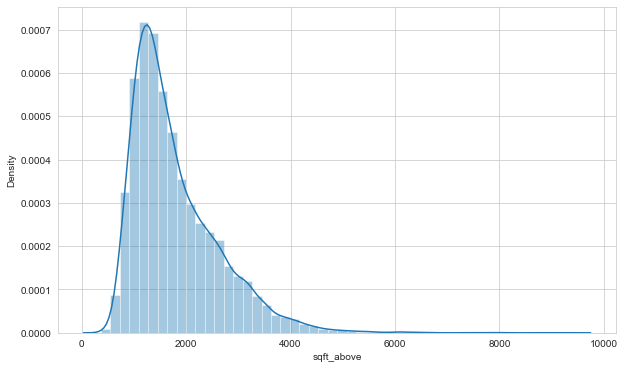

In [48]:
sns.distplot(df['sqft_above']);
# evin metrekare alanı genelde 1000 ve 4000 metrekare arasında

In [49]:
df['sqft_above'].value_counts(dropna = False)

1300    212
1010    210
1200    206
1220    192
1140    184
       ... 
3674      1
2979      1
2382      1
6290      1
1425      1
Name: sqft_above, Length: 942, dtype: int64

In [50]:
df[df["sqft_above"] > 6000].sort_values(by="sqft_above", ascending=False)
# 6000 metrekareden yüksek evlere baktık.

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
12764,2280000.000,7,8.000,13540,307752,3.000,0,4,3,12,9410,4130,1999,0,47.667,-121.986,4850,217800,0,0,0,0,1,0,0,0,0,0,0,0
9245,6890000.000,6,7.750,9890,31374,2.000,0,4,3,13,8860,1030,2001,0,47.630,-122.240,4540,42730,0,0,0,0,0,0,0,0,1,0,0,0
7245,7700000.000,6,8.000,12050,27600,2.500,0,3,4,13,8570,3480,1910,1987,47.630,-122.323,3940,8800,0,0,0,0,0,0,0,0,0,1,0,0
18288,3300000.000,5,6.250,8020,21738,2.000,0,0,3,11,8020,0,2001,0,47.568,-122.189,4160,18969,0,0,0,0,0,0,1,0,0,0,0,0
13398,2420000.000,5,4.750,7880,24250,2.000,0,2,3,13,7880,0,1996,0,47.733,-122.362,2740,10761,1,0,0,0,0,0,0,0,0,0,0,0
19842,2700000.000,4,4.000,7850,89651,2.000,0,0,3,12,7850,0,2006,0,47.541,-121.982,6210,95832,1,0,0,0,0,0,0,0,0,0,0,0
3910,7060000.000,5,4.500,10040,37325,2.000,1,2,3,11,7680,2360,1940,2001,47.650,-122.214,3930,25449,0,0,0,0,0,1,0,0,0,0,0,0
11859,1950000.000,4,3.250,7420,167869,2.000,0,3,3,12,7420,0,2002,0,47.455,-121.764,5610,169549,1,0,0,0,0,0,0,0,0,0,0,0
18579,1140000.000,5,4.000,7320,217800,2.000,0,0,3,11,7320,0,1992,0,47.447,-122.086,3270,34500,0,0,0,0,0,0,1,0,0,0,0,0
1446,5350000.000,5,5.000,8000,23985,2.000,0,4,3,12,6720,1280,2009,0,47.623,-122.220,4600,21750,0,0,0,1,0,0,0,0,0,0,0,0


### Geographical Properties

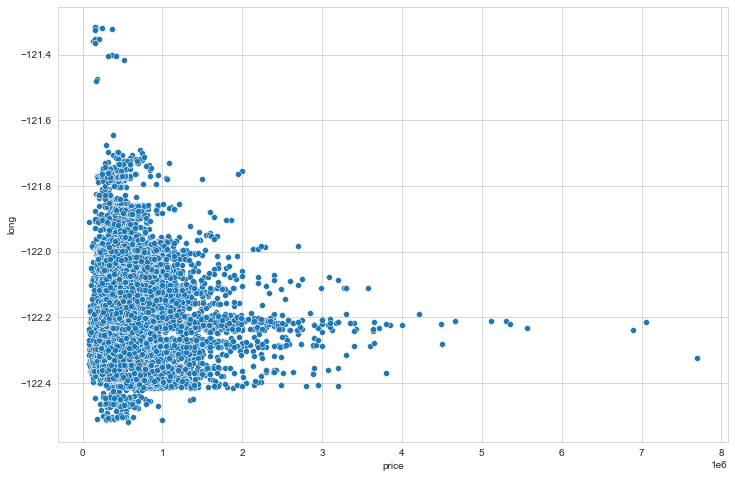

In [51]:
plt.figure(figsize = (12, 8))
sns.scatterplot(x = 'price', y = 'long', data = df);
# fiyat ile boylam arasında ki ilişkşye baktık. -121.8 den sonra fiyatlar yükselmilş.

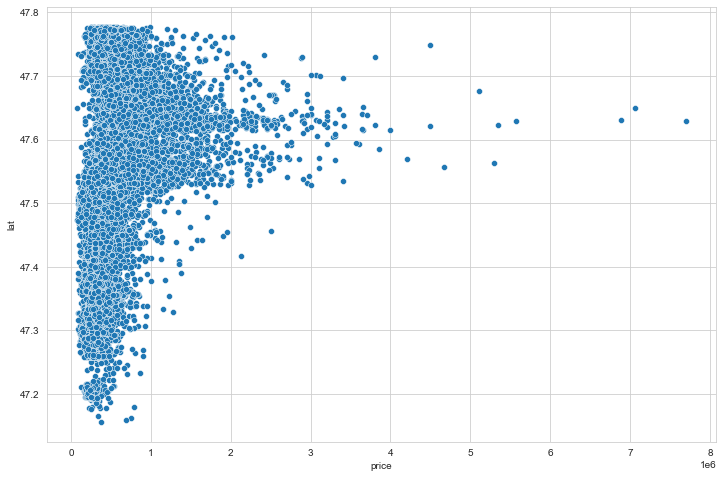

In [52]:
plt.figure(figsize  = (12, 8))
sns.scatterplot(x = 'price', y = 'lat', data = df);

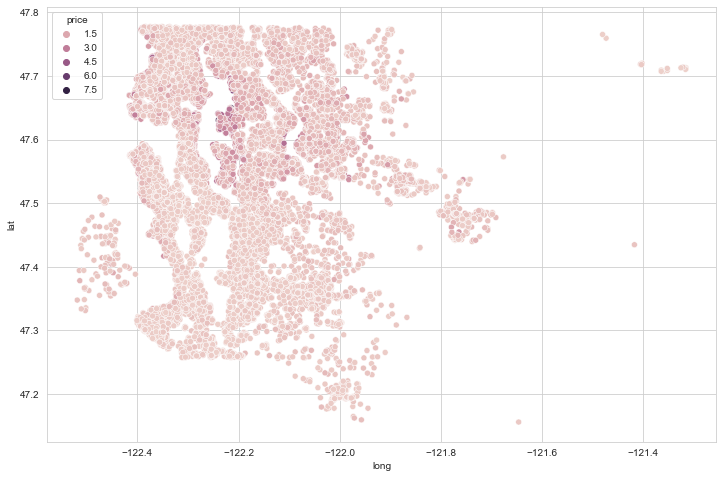

In [53]:
plt.figure(figsize = (12, 8))
sns.scatterplot(x = 'long', y = 'lat', data = df, hue = 'price');
# koyu renkli olanlar ev fiyatları oldukça yüksek olanlar.

In [54]:
len(df) * (0.01)
# datanın 216 satırına bakalım. %1 inine

215.97

In [55]:
df.sort_values('price', ascending = False).head(216)

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
7245,7700000.000,6,8.000,12050,27600,2.500,0,3,4,13,8570,3480,1910,1987,47.630,-122.323,3940,8800,0,0,0,0,0,0,0,0,0,1,0,0
3910,7060000.000,5,4.500,10040,37325,2.000,1,2,3,11,7680,2360,1940,2001,47.650,-122.214,3930,25449,0,0,0,0,0,1,0,0,0,0,0,0
9245,6890000.000,6,7.750,9890,31374,2.000,0,4,3,13,8860,1030,2001,0,47.630,-122.240,4540,42730,0,0,0,0,0,0,0,0,1,0,0,0
4407,5570000.000,5,5.750,9200,35069,2.000,0,0,3,13,6200,3000,2001,0,47.629,-122.233,3560,24345,0,0,0,0,0,0,0,1,0,0,0,0
1446,5350000.000,5,5.000,8000,23985,2.000,0,4,3,12,6720,1280,2009,0,47.623,-122.220,4600,21750,0,0,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19513,1980000.000,4,4.000,4360,12081,2.000,0,0,3,10,4360,0,2007,0,47.638,-122.219,2180,10800,0,0,0,0,0,0,0,1,0,0,0,0
7408,1980000.000,6,4.500,4800,9097,2.000,0,0,3,10,3580,1220,2007,0,47.626,-122.291,2180,6037,0,0,0,0,0,0,1,0,0,0,0,0
16511,1980000.000,4,3.500,4500,44384,1.000,0,0,3,12,3340,1160,1990,0,47.632,-122.192,2540,26287,0,1,0,0,0,0,0,0,0,0,0,0
3278,1970000.000,5,3.750,3940,13738,1.500,0,3,4,9,3940,0,1951,0,47.620,-122.212,2370,13320,0,1,0,0,0,0,0,0,0,0,0,0


In [56]:
non_top_1_perc = df.sort_values('price', ascending = False).iloc[216:]

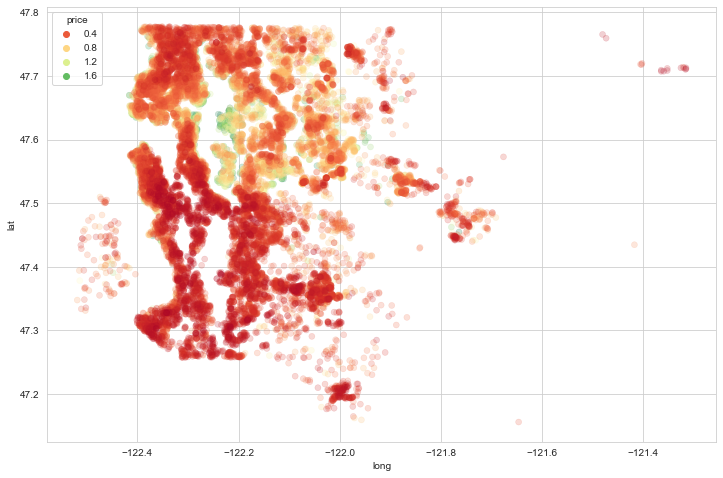

In [57]:
plt.figure(figsize = (12, 8))
sns.scatterplot(x = 'long', y = 'lat', data = non_top_1_perc, hue = 'price',
                palette = 'RdYlGn', edgecolor = None, alpha = 0.2);
# datanın %1 lik kısmını gösterecek şekilde baktık.

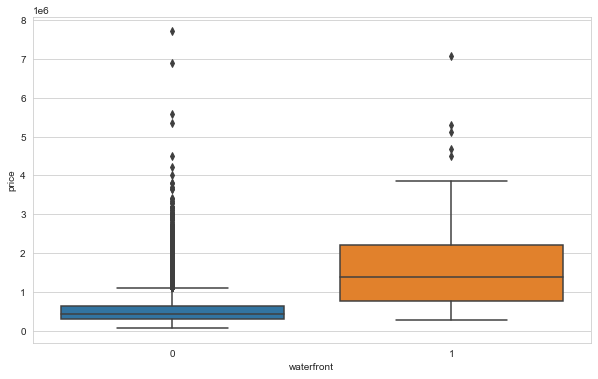

In [58]:
sns.boxplot(x = 'waterfront', y = 'price', data = df);
# deniz kenarına yakınlığı ev fiyatlarını biraz arttırıyor.

In [59]:
import folium
folium.Map(location=[df["lat"].mean(), df["long"].mean()], zoom_start=10)
# datamızda ki enlem ve boylam kodları ile haritada gösterdik.

In [60]:
map_kc = folium.Map(location=[df["lat"].mean(), df["long"].mean()], zoom_start = 10) # location=[47.511,  -122.257]
for lat, lng in zip(df['lat'], df['long']):
    folium.CircleMarker(
        [lat, lng],
        radius = 1,
        color = 'blue',
        fill = False ,
        fill_color ='#3186CC',
        fill_opacity = 0.3).add_to(map_kc)
map_kc
# evlerin bulunduğu alanı renklendirdik. verileri haritaya yerleştirdik.

### Ev fiyatlarına göre renklendirme : 

In [61]:
import folium
import branca.colormap as cm

step_1 = df.price.min()
step_2 = df.price.quantile(0.25)
step_3 = df.price.quantile(0.50)
step_4 = df.price.quantile(0.75)
step_5 = df.price.max()

m = folium.Map(location=[df["lat"].mean(), df["long"].mean()], zoom_start = 10)
colormap = cm.StepColormap(colors=["green","yellow","orange","red"] ,
                           index=[step_1, step_2, step_3, step_4, step_5],
                           vmin=step_1,
                           vmax=step_5)

for loc, p in zip(zip(df['lat'], df['long']),df["price"]):
      folium.Circle(
      location=loc,
      radius=1, #yarıçap
      fill=True, 
      color=colormap(p)
      ).add_to(m)
m

In [62]:
#from folium import plugins => MarkerCluster() için

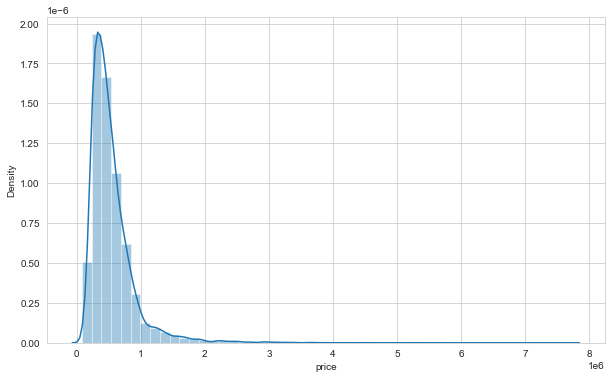

In [63]:
sns.distplot(df['price']);
# fiyatlar ağırlıklı olarak 500 bin dolar ve 2 milyon dolar arasındadır.

### latest data

In [65]:
df.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,lat,long,sqft_living15,sqft_lot15,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
0,221900.000,3,1.000,1180,5650,1.000,0,0,3,7,1180,0,1955,0,47.511,-122.257,1340,5650,0,0,0,0,0,0,0,0,0,1,0,0
1,538000.000,3,2.250,2570,7242,2.000,0,0,3,7,2170,400,1951,1991,47.721,-122.319,1690,7639,0,0,0,0,0,0,0,0,0,0,0,1
2,180000.000,2,1.000,770,10000,1.000,0,0,3,6,770,0,1933,0,47.738,-122.233,2720,8062,0,1,0,0,0,0,0,0,0,0,0,0
3,604000.000,4,3.000,1960,5000,1.000,0,0,5,7,1050,910,1965,0,47.521,-122.393,1360,5000,0,0,0,0,0,0,0,0,0,0,0,1
4,510000.000,3,2.000,1680,8080,1.000,0,0,3,8,1680,0,1987,0,47.617,-122.045,1800,7503,0,1,0,0,0,0,0,0,0,0,0,0


In [66]:
df.shape

(21597, 30)

## Preprocessing of Data
- Train | Test Split, Scalling

In [67]:
from sklearn.model_selection import train_test_split

In [68]:
X = df.drop('price', axis = 1)
y = df['price']

In [69]:
seed = 101

In [70]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=seed)

In [71]:
from sklearn.preprocessing import MinMaxScaler 
# deep learning için minmaxscaler yaptık. istersek RobutScaler de kullanılabilir.

In [72]:
scaler = MinMaxScaler()

In [73]:
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

## Modelling & Model Performance

In [74]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation

# ilk önce tensorflow kütüphanesini import ettik.
# sonra tensorflow keras models içinden sequential import edildi. katman modeli oluşturmak için.
# sonra tensorflow keras layers içinden dense import edildi. katmanların cinsini dense olarak belirledik. ANN de dense
# sonra tensorflow keras layers içinden Activation import edildi. activasyon fonksiyonlarını kullanmak için.

In [75]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, explained_variance_score, r2_score

In [76]:
def eval_metric(actual, pred):
    mae = mean_absolute_error(actual, pred)
    mse = mean_squared_error(actual, pred)
    rmse = np.sqrt(mean_squared_error(actual, pred))
    score = r2_score(actual, pred)
    return print("r2_score:", score, "\nmae:", mae, "\nmse:", mse, "\nrmse:", rmse)

In [77]:
X_train_scaled.shape

(17277, 29)

In [78]:
len(X_train.columns)

29

In [79]:
# katmanlarda genellikle future sayısı kadar noronla başlanması tavsiye edilir. sonrasında ister yarısı kadar, ister 3/2 kadar
# azaltarak devam edilebilir.

In [80]:
tf.random.set_seed(seed) # katman oluştururken random 101 ile çeksin değerler karışmasın. aynı skorları almak için.
# noron sayılarını ilk başta train setinde ki tüm sutun sayımızı verdik, sonra yarıya bölerek verdik.
model = Sequential()
model.add(Dense(units = len(X_train.columns), activation="relu", input_dim = X_train_scaled.shape[1])) # ilk katmana input_dim
model.add(Dense(units=len(X_train.columns), activation = "relu"))
model.add(Dense(units= 16, activation="relu"))
model.add(Dense(units= 8, activation="relu"))
model.add(Dense(units= 4, activation="relu"))
model.add(Dense(units= 1)) # output layer.

# activasyon olarak relu verdik, relu eğer mse skoru negatif çıkarsa sigmoid ile 0 ra yaklaştırır, pozitif ise dokunmaz.

In [81]:
model.compile(optimizer="adam", loss="mse")
# adam en güncell türev optimize işlemini yaptığı için adam seçtik.

In [82]:
model.weights
# modeldeki futurelerin ağırlıkları.

[<tf.Variable 'dense/kernel:0' shape=(29, 29) dtype=float32, numpy=
 array([[-1.70324743e-02, -1.51578441e-01, -3.13210070e-01,
         -1.69344082e-01, -2.32419372e-03,  1.83119476e-01,
          3.12089741e-01,  1.32420003e-01, -7.77235925e-02,
         -1.80055380e-01,  1.37490690e-01,  2.44639575e-01,
          2.31555283e-01, -6.62986040e-02, -2.74564326e-02,
         -1.35668695e-01,  2.61596382e-01,  8.22164118e-02,
          5.58787882e-02, -2.51106918e-01, -5.92915118e-02,
          2.22223699e-01,  2.98478782e-01, -2.02705756e-01,
         -7.43545145e-02,  4.26854789e-02,  1.53914899e-01,
          2.50992417e-01, -3.05378854e-01],
        [ 6.67949915e-02,  2.71055698e-01,  3.84545326e-02,
          9.87240672e-02,  4.28160727e-02,  3.17192078e-01,
          1.78963125e-01, -2.03873098e-01,  2.77073383e-02,
         -3.17017347e-01,  1.53067470e-01, -2.94106930e-01,
         -8.02034587e-02, -8.54518265e-02,  2.60613561e-01,
          8.22514594e-02,  3.08114409e-01, -1.64

In [106]:
y_train.shape

(17277,)

In [85]:
17277 / 128

134.9765625

In [88]:
128 * 115

14720

In [83]:
X_train_scaled.shape[0]/128

134.9765625

In [84]:
model.fit(x = X_train_scaled, y = y_train, validation_split = 0.15, batch_size = 128, epochs = 1000)

# validation_split = 0.15 demekle datanın en sonunda ki %15 lik kısmı ayır, eğitime dahil etme demektir.
# her eğitimde 128 satırda eğitime giren datanın en son %15 kısmını kullanmıyor. ayırıyor. her 128 satırda bir backprobagetion
# yapacak yani X_train_scaled tin satır sayısını batch_size değerine bölecek. çıkan sonucu yuvarlayıp o sonuç kadar her satırda
# veri alacak. satırın en son %15 lik kısmını eğitime sokmayacak. sonrasında her satır için loss değeri bulup bir sonraki satıra
# geçerken ağırklık değerlerini güncelleyecektir. 

# epoch 1 için 128 satıra 115 tane rastgele değer atadı ve 128 satırın loss değerlerinin ortalamasını buldu. işte epoch 1/1000 
# loss: 429961936896.0000 1 kere 128 satırdaki 115 tane değerin loss skorudur.

# val_loss: 409901826048.0000 ise 1. epoch ta skorunu aldığı 128 satıra denk gelen %15 değerin içine almadığımız %15 lik
# kısmını da dahil ederek aldığı hata loss değeridir. 

# her epochta datanını tamamını modele batch_size kadar sokuyor, her batch_size sonrası backprobagation yapıyor. en son datanın 
# tamamı tamamlandığı zaman bir loss değeri elde ediyor. sonra 2. epoch başlamadan önce ağırlık değerleri günecellenip tekrar 
# yapıyor.

her epochta 115 * 128 = 14720 tane veri için eğitim yapıp skor almaktadır.

Epoch 1/1000
115/115 [==============================] - 1s 4ms/step - loss: 428240961536.0000 - val_loss: 451796041728.0000
Epoch 2/1000
115/115 [==============================] - 0s 3ms/step - loss: 427695702016.0000 - val_loss: 449455095808.0000
Epoch 3/1000
115/115 [==============================] - 0s 3ms/step - loss: 413961420800.0000 - val_loss: 411920629760.0000
Epoch 4/1000
115/115 [==============================] - 0s 3ms/step - loss: 319995838464.0000 - val_loss: 244224557056.0000
Epoch 5/1000
115/115 [==============================] - 0s 3ms/step - loss: 143512289280.0000 - val_loss: 117840150528.0000
Epoch 6/1000
115/115 [==============================] - 0s 3ms/step - loss: 98465300480.0000 - val_loss: 113585070080.0000
Epoch 7/1000
115/115 [==============================] - 0s 2ms/step - loss: 96496001024.0000 - val_loss: 111650447360.0000
Epoch 8/1000
115/115 [==============================] - 0s 3ms/step - loss: 94744059904.0000 - val_loss: 109558595584.0000
Epoch 9/100

115/115 [==============================] - 0s 3ms/step - loss: 36026449920.0000 - val_loss: 42429587456.0000
Epoch 68/1000
115/115 [==============================] - 0s 4ms/step - loss: 35818999808.0000 - val_loss: 42213478400.0000
Epoch 69/1000
115/115 [==============================] - 0s 3ms/step - loss: 35578388480.0000 - val_loss: 41885077504.0000
Epoch 70/1000
115/115 [==============================] - 0s 3ms/step - loss: 35428806656.0000 - val_loss: 41601167360.0000
Epoch 71/1000
115/115 [==============================] - 0s 3ms/step - loss: 35217653760.0000 - val_loss: 41678209024.0000
Epoch 72/1000
115/115 [==============================] - 0s 3ms/step - loss: 35077181440.0000 - val_loss: 41297559552.0000
Epoch 73/1000
115/115 [==============================] - 0s 3ms/step - loss: 34901745664.0000 - val_loss: 40875843584.0000
Epoch 74/1000
115/115 [==============================] - 0s 3ms/step - loss: 34733740032.0000 - val_loss: 40652390400.0000
Epoch 75/1000
115/115 [=======

115/115 [==============================] - 0s 3ms/step - loss: 31328995328.0000 - val_loss: 35930468352.0000
Epoch 134/1000
115/115 [==============================] - 0s 3ms/step - loss: 31267346432.0000 - val_loss: 35775447040.0000
Epoch 135/1000
115/115 [==============================] - 0s 3ms/step - loss: 31244908544.0000 - val_loss: 35673935872.0000
Epoch 136/1000
115/115 [==============================] - 0s 2ms/step - loss: 31241504768.0000 - val_loss: 36087676928.0000
Epoch 137/1000
115/115 [==============================] - 0s 3ms/step - loss: 31218092032.0000 - val_loss: 35695923200.0000
Epoch 138/1000
115/115 [==============================] - 0s 2ms/step - loss: 31163883520.0000 - val_loss: 35785625600.0000
Epoch 139/1000
115/115 [==============================] - 0s 2ms/step - loss: 31195746304.0000 - val_loss: 35554791424.0000
Epoch 140/1000
115/115 [==============================] - 0s 2ms/step - loss: 31186917376.0000 - val_loss: 35602477056.0000
Epoch 141/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 29942691840.0000 - val_loss: 34359349248.0000
Epoch 200/1000
115/115 [==============================] - 0s 2ms/step - loss: 29945063424.0000 - val_loss: 34153242624.0000
Epoch 201/1000
115/115 [==============================] - 0s 2ms/step - loss: 29878984704.0000 - val_loss: 34159108096.0000
Epoch 202/1000
115/115 [==============================] - 0s 2ms/step - loss: 29879461888.0000 - val_loss: 34118264832.0000
Epoch 203/1000
115/115 [==============================] - 0s 2ms/step - loss: 29838745600.0000 - val_loss: 34077603840.0000
Epoch 204/1000
115/115 [==============================] - 0s 2ms/step - loss: 29855371264.0000 - val_loss: 34295132160.0000
Epoch 205/1000
115/115 [==============================] - 0s 2ms/step - loss: 29826596864.0000 - val_loss: 34058868736.0000
Epoch 206/1000
115/115 [==============================] - 0s 2ms/step - loss: 29808601088.0000 - val_loss: 34237730816.0000
Epoch 207/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 28998596608.0000 - val_loss: 33223550976.0000
Epoch 266/1000
115/115 [==============================] - 0s 2ms/step - loss: 28988282880.0000 - val_loss: 33166931968.0000
Epoch 267/1000
115/115 [==============================] - 0s 2ms/step - loss: 28975759360.0000 - val_loss: 33538314240.0000
Epoch 268/1000
115/115 [==============================] - 0s 3ms/step - loss: 28979664896.0000 - val_loss: 33902540800.0000
Epoch 269/1000
115/115 [==============================] - 0s 3ms/step - loss: 28973412352.0000 - val_loss: 33274566656.0000
Epoch 270/1000
115/115 [==============================] - 0s 2ms/step - loss: 28986918912.0000 - val_loss: 33318266880.0000
Epoch 271/1000
115/115 [==============================] - 0s 2ms/step - loss: 28955801600.0000 - val_loss: 33246328832.0000
Epoch 272/1000
115/115 [==============================] - 0s 2ms/step - loss: 28885835776.0000 - val_loss: 33277546496.0000
Epoch 273/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 27986155520.0000 - val_loss: 32705505280.0000
Epoch 332/1000
115/115 [==============================] - 0s 2ms/step - loss: 27943395328.0000 - val_loss: 32342646784.0000
Epoch 333/1000
115/115 [==============================] - 0s 2ms/step - loss: 27934466048.0000 - val_loss: 32197038080.0000
Epoch 334/1000
115/115 [==============================] - 0s 2ms/step - loss: 27938422784.0000 - val_loss: 32603461632.0000
Epoch 335/1000
115/115 [==============================] - 0s 2ms/step - loss: 27912591360.0000 - val_loss: 32573370368.0000
Epoch 336/1000
115/115 [==============================] - 0s 2ms/step - loss: 27908841472.0000 - val_loss: 32306831360.0000
Epoch 337/1000
115/115 [==============================] - 0s 2ms/step - loss: 27876122624.0000 - val_loss: 32766414848.0000
Epoch 338/1000
115/115 [==============================] - 0s 2ms/step - loss: 27835777024.0000 - val_loss: 32217856000.0000
Epoch 339/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 26823202816.0000 - val_loss: 31395481600.0000
Epoch 398/1000
115/115 [==============================] - 0s 3ms/step - loss: 26798854144.0000 - val_loss: 31329789952.0000
Epoch 399/1000
115/115 [==============================] - 0s 3ms/step - loss: 26812524544.0000 - val_loss: 31469064192.0000
Epoch 400/1000
115/115 [==============================] - 0s 2ms/step - loss: 26818400256.0000 - val_loss: 31855030272.0000
Epoch 401/1000
115/115 [==============================] - 0s 2ms/step - loss: 26758621184.0000 - val_loss: 31306987520.0000
Epoch 402/1000
115/115 [==============================] - 0s 2ms/step - loss: 26757640192.0000 - val_loss: 31288627200.0000
Epoch 403/1000
115/115 [==============================] - 0s 2ms/step - loss: 26781251584.0000 - val_loss: 31399841792.0000
Epoch 404/1000
115/115 [==============================] - 0s 3ms/step - loss: 26777167872.0000 - val_loss: 31378976768.0000
Epoch 405/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 25994883072.0000 - val_loss: 31205081088.0000
Epoch 464/1000
115/115 [==============================] - 0s 2ms/step - loss: 25982509056.0000 - val_loss: 31063406592.0000
Epoch 465/1000
115/115 [==============================] - 0s 2ms/step - loss: 25952737280.0000 - val_loss: 31155347456.0000
Epoch 466/1000
115/115 [==============================] - 0s 2ms/step - loss: 25943197696.0000 - val_loss: 30885576704.0000
Epoch 467/1000
115/115 [==============================] - 0s 2ms/step - loss: 25894588416.0000 - val_loss: 31107205120.0000
Epoch 468/1000
115/115 [==============================] - 0s 2ms/step - loss: 25913845760.0000 - val_loss: 31464122368.0000
Epoch 469/1000
115/115 [==============================] - 0s 2ms/step - loss: 25832998912.0000 - val_loss: 30683871232.0000
Epoch 470/1000
115/115 [==============================] - 0s 2ms/step - loss: 25987213312.0000 - val_loss: 30740015104.0000
Epoch 471/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 25246351360.0000 - val_loss: 30710784000.0000
Epoch 530/1000
115/115 [==============================] - 0s 2ms/step - loss: 25253371904.0000 - val_loss: 30758717440.0000
Epoch 531/1000
115/115 [==============================] - 0s 2ms/step - loss: 25235576832.0000 - val_loss: 31066161152.0000
Epoch 532/1000
115/115 [==============================] - 0s 2ms/step - loss: 25263532032.0000 - val_loss: 30969434112.0000
Epoch 533/1000
115/115 [==============================] - 0s 2ms/step - loss: 25234540544.0000 - val_loss: 30967666688.0000
Epoch 534/1000
115/115 [==============================] - 0s 2ms/step - loss: 25224814592.0000 - val_loss: 30849636352.0000
Epoch 535/1000
115/115 [==============================] - 0s 2ms/step - loss: 25236664320.0000 - val_loss: 31011385344.0000
Epoch 536/1000
115/115 [==============================] - 0s 2ms/step - loss: 25194813440.0000 - val_loss: 30774175744.0000
Epoch 537/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 24576575488.0000 - val_loss: 30947336192.0000
Epoch 596/1000
115/115 [==============================] - 0s 2ms/step - loss: 24556187648.0000 - val_loss: 31136288768.0000
Epoch 597/1000
115/115 [==============================] - 0s 2ms/step - loss: 24568078336.0000 - val_loss: 30871427072.0000
Epoch 598/1000
115/115 [==============================] - 0s 3ms/step - loss: 24534091776.0000 - val_loss: 30754482176.0000
Epoch 599/1000
115/115 [==============================] - 0s 2ms/step - loss: 24541159424.0000 - val_loss: 30921267200.0000
Epoch 600/1000
115/115 [==============================] - 0s 2ms/step - loss: 24492226560.0000 - val_loss: 31081912320.0000
Epoch 601/1000
115/115 [==============================] - 0s 2ms/step - loss: 24527304704.0000 - val_loss: 31202719744.0000
Epoch 602/1000
115/115 [==============================] - 0s 2ms/step - loss: 24538347520.0000 - val_loss: 30846103552.0000
Epoch 603/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 23199889408.0000 - val_loss: 30660597760.0000
Epoch 662/1000
115/115 [==============================] - 0s 2ms/step - loss: 23217967104.0000 - val_loss: 30001328128.0000
Epoch 663/1000
115/115 [==============================] - 0s 3ms/step - loss: 23119011840.0000 - val_loss: 30154518528.0000
Epoch 664/1000
115/115 [==============================] - 0s 3ms/step - loss: 23128795136.0000 - val_loss: 30142138368.0000
Epoch 665/1000
115/115 [==============================] - 0s 3ms/step - loss: 23084685312.0000 - val_loss: 29933615104.0000
Epoch 666/1000
115/115 [==============================] - 0s 3ms/step - loss: 23060135936.0000 - val_loss: 29737719808.0000
Epoch 667/1000
115/115 [==============================] - 0s 3ms/step - loss: 23041880064.0000 - val_loss: 30205911040.0000
Epoch 668/1000
115/115 [==============================] - 0s 3ms/step - loss: 23025553408.0000 - val_loss: 29889562624.0000
Epoch 669/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 20493703168.0000 - val_loss: 28656467968.0000
Epoch 728/1000
115/115 [==============================] - 0s 2ms/step - loss: 20407453696.0000 - val_loss: 29299566592.0000
Epoch 729/1000
115/115 [==============================] - 0s 2ms/step - loss: 20427382784.0000 - val_loss: 28428451840.0000
Epoch 730/1000
115/115 [==============================] - 0s 2ms/step - loss: 20397524992.0000 - val_loss: 28766232576.0000
Epoch 731/1000
115/115 [==============================] - 0s 2ms/step - loss: 20328765440.0000 - val_loss: 28781359104.0000
Epoch 732/1000
115/115 [==============================] - 0s 3ms/step - loss: 20241772544.0000 - val_loss: 28755890176.0000
Epoch 733/1000
115/115 [==============================] - 0s 2ms/step - loss: 20226947072.0000 - val_loss: 28609558528.0000
Epoch 734/1000
115/115 [==============================] - 0s 3ms/step - loss: 20141479936.0000 - val_loss: 28424876032.0000
Epoch 735/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 18248009728.0000 - val_loss: 27546877952.0000
Epoch 794/1000
115/115 [==============================] - 0s 2ms/step - loss: 18308046848.0000 - val_loss: 27606265856.0000
Epoch 795/1000
115/115 [==============================] - 0s 2ms/step - loss: 18202767360.0000 - val_loss: 27048065024.0000
Epoch 796/1000
115/115 [==============================] - 0s 2ms/step - loss: 18196873216.0000 - val_loss: 26992715776.0000
Epoch 797/1000
115/115 [==============================] - 0s 3ms/step - loss: 18159032320.0000 - val_loss: 26961645568.0000
Epoch 798/1000
115/115 [==============================] - 0s 3ms/step - loss: 18140272640.0000 - val_loss: 27085094912.0000
Epoch 799/1000
115/115 [==============================] - 0s 3ms/step - loss: 18111141888.0000 - val_loss: 27382345728.0000
Epoch 800/1000
115/115 [==============================] - 0s 2ms/step - loss: 18102464512.0000 - val_loss: 26924396544.0000
Epoch 801/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 16919422976.0000 - val_loss: 26807988224.0000
Epoch 860/1000
115/115 [==============================] - 0s 2ms/step - loss: 16882529280.0000 - val_loss: 26949142528.0000
Epoch 861/1000
115/115 [==============================] - 0s 2ms/step - loss: 16911995904.0000 - val_loss: 26703106048.0000
Epoch 862/1000
115/115 [==============================] - 0s 2ms/step - loss: 16844884992.0000 - val_loss: 26989826048.0000
Epoch 863/1000
115/115 [==============================] - 0s 3ms/step - loss: 16837372928.0000 - val_loss: 26858375168.0000
Epoch 864/1000
115/115 [==============================] - 0s 3ms/step - loss: 16854449152.0000 - val_loss: 26856155136.0000
Epoch 865/1000
115/115 [==============================] - 0s 2ms/step - loss: 16846969856.0000 - val_loss: 26803576832.0000
Epoch 866/1000
115/115 [==============================] - 0s 2ms/step - loss: 16765794304.0000 - val_loss: 27030982656.0000
Epoch 867/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 15897121792.0000 - val_loss: 26820861952.0000
Epoch 926/1000
115/115 [==============================] - 0s 2ms/step - loss: 15887133696.0000 - val_loss: 27236665344.0000
Epoch 927/1000
115/115 [==============================] - 0s 3ms/step - loss: 15859211264.0000 - val_loss: 26589556736.0000
Epoch 928/1000
115/115 [==============================] - 0s 3ms/step - loss: 15866088448.0000 - val_loss: 26519885824.0000
Epoch 929/1000
115/115 [==============================] - 0s 3ms/step - loss: 15880518656.0000 - val_loss: 26606845952.0000
Epoch 930/1000
115/115 [==============================] - 0s 3ms/step - loss: 15842603008.0000 - val_loss: 27407312896.0000
Epoch 931/1000
115/115 [==============================] - 0s 3ms/step - loss: 15738550272.0000 - val_loss: 26427002880.0000
Epoch 932/1000
115/115 [==============================] - 0s 2ms/step - loss: 15799320576.0000 - val_loss: 27204055040.0000
Epoch 933/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 14928239616.0000 - val_loss: 26488768512.0000
Epoch 992/1000
115/115 [==============================] - 0s 3ms/step - loss: 14889579520.0000 - val_loss: 27095453696.0000
Epoch 993/1000
115/115 [==============================] - 0s 2ms/step - loss: 14998539264.0000 - val_loss: 26821591040.0000
Epoch 994/1000
115/115 [==============================] - 0s 2ms/step - loss: 14922136576.0000 - val_loss: 27214235648.0000
Epoch 995/1000
115/115 [==============================] - 0s 2ms/step - loss: 14911202304.0000 - val_loss: 27046180864.0000
Epoch 996/1000
115/115 [==============================] - 0s 2ms/step - loss: 14949878784.0000 - val_loss: 26490464256.0000
Epoch 997/1000
115/115 [==============================] - 0s 2ms/step - loss: 14890362880.0000 - val_loss: 28049537024.0000
Epoch 998/1000
115/115 [==============================] - 0s 2ms/step - loss: 14929696768.0000 - val_loss: 26912864256.0000
Epoch 999/1000
115/115 

In [110]:
model.summary()
# 29 *29 = 841 + 29 = 870 parametre.
# 15*29 + 15 = 450 parametre 
# 15*8 + 8 = 128 parametre
# 8*4 +4 = 26 parametre
# 4*1 +1 = 5 parametre

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 29)                870       
                                                                 
 dense_1 (Dense)             (None, 29)                870       
                                                                 
 dense_2 (Dense)             (None, 15)                450       
                                                                 
 dense_3 (Dense)             (None, 8)                 128       
                                                                 
 dense_4 (Dense)             (None, 4)                 36        
                                                                 
 dense_5 (Dense)             (None, 1)                 5         
                                                                 
Total params: 2,359
Trainable params: 2,359
Non-trainabl

In [96]:
model.weights

[<tf.Variable 'dense/kernel:0' shape=(29, 29) dtype=float32, numpy=
 array([[ 9.00722593e-02, -9.31946412e-02,  2.20754534e-01,
         -6.00857973e-01, -1.76737106e+00, -4.88201857e-01,
         -1.95340842e-01, -2.81054936e-02, -7.14461207e-01,
         -5.04688442e-01,  2.56985724e-01, -4.16045971e-02,
         -3.32075119e-01, -9.27850604e-02,  5.68684042e-01,
         -2.09835911e+00, -9.29524958e-01, -6.31313980e-01,
         -1.13767719e+00, -1.19511771e+00, -4.13710237e-01,
          5.02131879e-01,  5.74947476e-01, -3.89732838e-01,
         -6.29771650e-02, -5.75755417e-01, -6.93440795e-01,
         -1.90623748e+00, -4.71316069e-01],
        [ 7.73750722e-01,  1.35472625e-01,  1.48113704e+00,
          8.60458314e-02,  9.78833497e-01, -6.42765090e-02,
          1.06718123e-01,  1.85660288e-01,  1.83796501e+00,
         -2.43254051e-01,  6.30758524e-01,  1.76959860e+00,
          1.61743730e-01,  2.72267103e-01,  1.47193730e+00,
          1.69044495e+00,  8.22906077e-01,  2.71

In [89]:
pd.DataFrame(model.history.history)
# loss val_splitte eklenmemiş hata oranı mse skoru, val_loss ise %15 lik kısmının eklenmiş hali.

,loss,val_loss
0,428240961536.000,451796041728.000
1,427695702016.000,449455095808.000
2,413961420800.000,411920629760.000
3,319995838464.000,244224557056.000
4,143512289280.000,117840150528.000
...,...,...
995,14949878784.000,26490464256.000
996,14890362880.000,28049537024.000
997,14929696768.000,26912864256.000
998,14849457152.000,27096809472.000


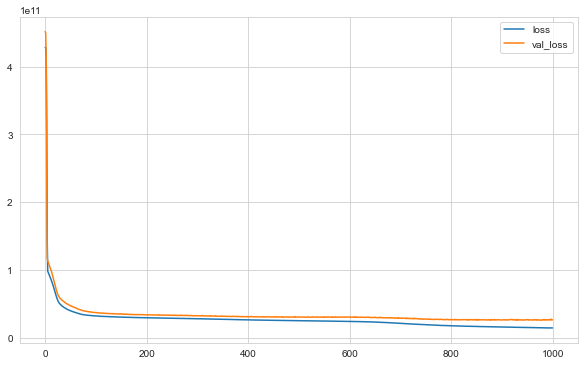

In [90]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot();

# loss ve val_loss arasında çok az bir fark var oldukça iyi.

In [94]:
loss_df[(loss_df["val_loss"] == loss_df["val_loss"].min())]

,loss,val_loss
978,15135506432.000,26291849216.000


In [95]:
loss_df[(loss_df["loss"] == loss_df["loss"].min())]

,loss,val_loss
998,14849457152.000,27096809472.000


In [97]:
model.evaluate(X_test_scaled, y_test, verbose=0)
# testte göre mse skorunu aldık. X_test_scaled datasıyla mse skorlarını aldık.

19186229248.0

In [98]:
y_pred = model.predict(X_test_scaled)

In [99]:
y_pred2 = model.predict(X_train_scaled)

In [100]:
eval_metric(y_test, y_pred)
# yaklaşık 78 bin dolarlık hatamız var. mae skoru.

r2_score: 0.84363463039648 
mae: 78926.44308449075 
mse: 19186235069.8704 
rmse: 138514.38578671313


In [102]:
eval_metric(y_train, y_pred2)
# mae skoru 77 bin dolar civarı. özetle skoarlar arasında büyük farklar yok. overfiting durumu yok.

r2_score: 0.8804909451630962 
mae: 77263.76095703464 
mse: 16492472969.184505 
rmse: 128423.02351675305


### learning_rate : 

step_size = türev * learning_rate yani loss değerlerine göre lossun ilk ağırlık noktası ile türevi alındıktan sonra türev alınacak diğer noktaya step_size ile ulaşılır. örneğin w = 1 olsun başlangıç ağırlık katsayımız. yi = w*future+b olsun. burda tahmin = future + b dir. sonra (gerçek - tahmin)**2 = mse skoru bulunur. sonra lossun 1 e göre türevi alınır. sonra elde edilen türev learnig_rate ile çarpılıp adım sayımız bulunur. sonra adım sayımız ilk bulduğumuz türeve eklenip yeni bulunan noktaya göre türevi alınıp ve 2. satıra geçerken yeni w değeri bulunur.  

In [103]:
from tensorflow.keras.optimizers import Adam
# optimizer içinden Adam import ettik. Adam en çok kullanılan optimizer methodudur. 

In [104]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(units= 29, activation = 'relu', input_dim = X_train.shape[1])) 
model.add(Dense(29, activation = 'relu'))
model.add(Dense(15, activation = 'relu'))
model.add(Dense(8, activation = 'relu'))
model.add(Dense(1))

opt = Adam(lr = 0.003) # default learning rate value is 0.001 biz ise 0.003 değerini verdik.
model.compile(optimizer = opt, loss = 'mse')

In [105]:
model.weights

[<tf.Variable 'dense_6/kernel:0' shape=(29, 29) dtype=float32, numpy=
 array([[-1.70324743e-02, -1.51578441e-01, -3.13210070e-01,
         -1.69344082e-01, -2.32419372e-03,  1.83119476e-01,
          3.12089741e-01,  1.32420003e-01, -7.77235925e-02,
         -1.80055380e-01,  1.37490690e-01,  2.44639575e-01,
          2.31555283e-01, -6.62986040e-02, -2.74564326e-02,
         -1.35668695e-01,  2.61596382e-01,  8.22164118e-02,
          5.58787882e-02, -2.51106918e-01, -5.92915118e-02,
          2.22223699e-01,  2.98478782e-01, -2.02705756e-01,
         -7.43545145e-02,  4.26854789e-02,  1.53914899e-01,
          2.50992417e-01, -3.05378854e-01],
        [ 6.67949915e-02,  2.71055698e-01,  3.84545326e-02,
          9.87240672e-02,  4.28160727e-02,  3.17192078e-01,
          1.78963125e-01, -2.03873098e-01,  2.77073383e-02,
         -3.17017347e-01,  1.53067470e-01, -2.94106930e-01,
         -8.02034587e-02, -8.54518265e-02,  2.60613561e-01,
          8.22514594e-02,  3.08114409e-01, -1.

In [106]:
model.fit(x = X_train_scaled, y = y_train, validation_split = 0.15, batch_size = 128, epochs = 1000)
# default learning_rate den 0.001 den 0.03 e çıkararak loss skorlarına bakacağız.

Epoch 1/1000
115/115 [==============================] - 1s 4ms/step - loss: 428012568576.0000 - val_loss: 450024570880.0000
Epoch 2/1000
115/115 [==============================] - 0s 3ms/step - loss: 389030248448.0000 - val_loss: 310554492928.0000
Epoch 3/1000
115/115 [==============================] - 0s 3ms/step - loss: 147774849024.0000 - val_loss: 114264891392.0000
Epoch 4/1000
115/115 [==============================] - 0s 3ms/step - loss: 96053510144.0000 - val_loss: 109922852864.0000
Epoch 5/1000
115/115 [==============================] - 0s 3ms/step - loss: 92362817536.0000 - val_loss: 105979019264.0000
Epoch 6/1000
115/115 [==============================] - 0s 2ms/step - loss: 88723120128.0000 - val_loss: 101350432768.0000
Epoch 7/1000
115/115 [==============================] - 0s 3ms/step - loss: 84764098560.0000 - val_loss: 96822517760.0000
Epoch 8/1000
115/115 [==============================] - 0s 3ms/step - loss: 80574816256.0000 - val_loss: 91808882688.0000
Epoch 9/1000
11

115/115 [==============================] - 0s 3ms/step - loss: 31458844672.0000 - val_loss: 35882725376.0000
Epoch 68/1000
115/115 [==============================] - 0s 2ms/step - loss: 31412381696.0000 - val_loss: 35974508544.0000
Epoch 69/1000
115/115 [==============================] - 0s 2ms/step - loss: 31317450752.0000 - val_loss: 35731435520.0000
Epoch 70/1000
115/115 [==============================] - 0s 2ms/step - loss: 31343333376.0000 - val_loss: 35694723072.0000
Epoch 71/1000
115/115 [==============================] - 0s 2ms/step - loss: 31252948992.0000 - val_loss: 36163960832.0000
Epoch 72/1000
115/115 [==============================] - 0s 2ms/step - loss: 31210475520.0000 - val_loss: 35824451584.0000
Epoch 73/1000
115/115 [==============================] - 0s 2ms/step - loss: 31154485248.0000 - val_loss: 35469926400.0000
Epoch 74/1000
115/115 [==============================] - 0s 2ms/step - loss: 31084314624.0000 - val_loss: 35395739648.0000
Epoch 75/1000
115/115 [=======

115/115 [==============================] - 0s 2ms/step - loss: 29358501888.0000 - val_loss: 34034837504.0000
Epoch 134/1000
115/115 [==============================] - 0s 2ms/step - loss: 29314097152.0000 - val_loss: 33688840192.0000
Epoch 135/1000
115/115 [==============================] - 0s 2ms/step - loss: 29310550016.0000 - val_loss: 33410297856.0000
Epoch 136/1000
115/115 [==============================] - 0s 2ms/step - loss: 29326749696.0000 - val_loss: 34626465792.0000
Epoch 137/1000
115/115 [==============================] - 0s 2ms/step - loss: 29338251264.0000 - val_loss: 33536194560.0000
Epoch 138/1000
115/115 [==============================] - 0s 2ms/step - loss: 29251956736.0000 - val_loss: 33667119104.0000
Epoch 139/1000
115/115 [==============================] - 0s 2ms/step - loss: 29306064896.0000 - val_loss: 33407670272.0000
Epoch 140/1000
115/115 [==============================] - 0s 2ms/step - loss: 29283438592.0000 - val_loss: 33680642048.0000
Epoch 141/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 28227745792.0000 - val_loss: 33095084032.0000
Epoch 200/1000
115/115 [==============================] - 0s 3ms/step - loss: 28285286400.0000 - val_loss: 32446617600.0000
Epoch 201/1000
115/115 [==============================] - 0s 3ms/step - loss: 28185403392.0000 - val_loss: 32556042240.0000
Epoch 202/1000
115/115 [==============================] - 0s 3ms/step - loss: 28154521600.0000 - val_loss: 32438423552.0000
Epoch 203/1000
115/115 [==============================] - 0s 2ms/step - loss: 28103866368.0000 - val_loss: 32370372608.0000
Epoch 204/1000
115/115 [==============================] - 0s 3ms/step - loss: 28180549632.0000 - val_loss: 32494635008.0000
Epoch 205/1000
115/115 [==============================] - 0s 3ms/step - loss: 28110977024.0000 - val_loss: 32383700992.0000
Epoch 206/1000
115/115 [==============================] - 0s 2ms/step - loss: 28118079488.0000 - val_loss: 32860178432.0000
Epoch 207/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 26934360064.0000 - val_loss: 31784185856.0000
Epoch 266/1000
115/115 [==============================] - 0s 2ms/step - loss: 26885810176.0000 - val_loss: 31700688896.0000
Epoch 267/1000
115/115 [==============================] - 0s 2ms/step - loss: 26919342080.0000 - val_loss: 32226310144.0000
Epoch 268/1000
115/115 [==============================] - 0s 2ms/step - loss: 26934243328.0000 - val_loss: 32844797952.0000
Epoch 269/1000
115/115 [==============================] - 0s 2ms/step - loss: 26833821696.0000 - val_loss: 31815352320.0000
Epoch 270/1000
115/115 [==============================] - 0s 2ms/step - loss: 26862440448.0000 - val_loss: 32027324416.0000
Epoch 271/1000
115/115 [==============================] - 0s 2ms/step - loss: 26874982400.0000 - val_loss: 32171354112.0000
Epoch 272/1000
115/115 [==============================] - 0s 2ms/step - loss: 26756147200.0000 - val_loss: 32185085952.0000
Epoch 273/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 25491832832.0000 - val_loss: 32226371584.0000
Epoch 332/1000
115/115 [==============================] - 0s 2ms/step - loss: 25442791424.0000 - val_loss: 31667916800.0000
Epoch 333/1000
115/115 [==============================] - 0s 2ms/step - loss: 25444581376.0000 - val_loss: 31327191040.0000
Epoch 334/1000
115/115 [==============================] - 0s 2ms/step - loss: 25424187392.0000 - val_loss: 31832614912.0000
Epoch 335/1000
115/115 [==============================] - 0s 2ms/step - loss: 25429073920.0000 - val_loss: 32175226880.0000
Epoch 336/1000
115/115 [==============================] - 0s 2ms/step - loss: 25387182080.0000 - val_loss: 31683321856.0000
Epoch 337/1000
115/115 [==============================] - 0s 3ms/step - loss: 25339430912.0000 - val_loss: 32414773248.0000
Epoch 338/1000
115/115 [==============================] - 0s 3ms/step - loss: 25321787392.0000 - val_loss: 31470665728.0000
Epoch 339/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 24562255872.0000 - val_loss: 32142004224.0000
Epoch 398/1000
115/115 [==============================] - 0s 2ms/step - loss: 24568389632.0000 - val_loss: 31872958464.0000
Epoch 399/1000
115/115 [==============================] - 0s 3ms/step - loss: 24554084352.0000 - val_loss: 32218255360.0000
Epoch 400/1000
115/115 [==============================] - 0s 2ms/step - loss: 24615028736.0000 - val_loss: 32927563776.0000
Epoch 401/1000
115/115 [==============================] - 0s 2ms/step - loss: 24536147968.0000 - val_loss: 31932903424.0000
Epoch 402/1000
115/115 [==============================] - 0s 2ms/step - loss: 24522129408.0000 - val_loss: 32061657088.0000
Epoch 403/1000
115/115 [==============================] - 0s 2ms/step - loss: 24546494464.0000 - val_loss: 32088489984.0000
Epoch 404/1000
115/115 [==============================] - 0s 2ms/step - loss: 24596252672.0000 - val_loss: 32141899776.0000
Epoch 405/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 23971469312.0000 - val_loss: 32663744512.0000
Epoch 464/1000
115/115 [==============================] - 0s 3ms/step - loss: 23952701440.0000 - val_loss: 32350478336.0000
Epoch 465/1000
115/115 [==============================] - 0s 4ms/step - loss: 23901366272.0000 - val_loss: 32942843904.0000
Epoch 466/1000
115/115 [==============================] - 0s 3ms/step - loss: 23927603200.0000 - val_loss: 32386060288.0000
Epoch 467/1000
115/115 [==============================] - 0s 3ms/step - loss: 23882348544.0000 - val_loss: 32382558208.0000
Epoch 468/1000
115/115 [==============================] - 0s 3ms/step - loss: 23879598080.0000 - val_loss: 33137373184.0000
Epoch 469/1000
115/115 [==============================] - 0s 3ms/step - loss: 23838869504.0000 - val_loss: 32299360256.0000
Epoch 470/1000
115/115 [==============================] - 0s 2ms/step - loss: 24037855232.0000 - val_loss: 32187686912.0000
Epoch 471/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 23468937216.0000 - val_loss: 32543973376.0000
Epoch 530/1000
115/115 [==============================] - 0s 2ms/step - loss: 23507519488.0000 - val_loss: 32680634368.0000
Epoch 531/1000
115/115 [==============================] - 0s 2ms/step - loss: 23489107968.0000 - val_loss: 32887812096.0000
Epoch 532/1000
115/115 [==============================] - 0s 2ms/step - loss: 23526084608.0000 - val_loss: 33311418368.0000
Epoch 533/1000
115/115 [==============================] - 0s 2ms/step - loss: 23504850944.0000 - val_loss: 32983154688.0000
Epoch 534/1000
115/115 [==============================] - 0s 2ms/step - loss: 23488901120.0000 - val_loss: 32674811904.0000
Epoch 535/1000
115/115 [==============================] - 0s 2ms/step - loss: 23524425728.0000 - val_loss: 32837031936.0000
Epoch 536/1000
115/115 [==============================] - 0s 2ms/step - loss: 23437037568.0000 - val_loss: 32690522112.0000
Epoch 537/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 23180838912.0000 - val_loss: 33051199488.0000
Epoch 596/1000
115/115 [==============================] - 0s 2ms/step - loss: 23137968128.0000 - val_loss: 33667332096.0000
Epoch 597/1000
115/115 [==============================] - 0s 2ms/step - loss: 23172608000.0000 - val_loss: 33043034112.0000
Epoch 598/1000
115/115 [==============================] - 0s 2ms/step - loss: 23168139264.0000 - val_loss: 32773199872.0000
Epoch 599/1000
115/115 [==============================] - 0s 2ms/step - loss: 23183314944.0000 - val_loss: 33252141056.0000
Epoch 600/1000
115/115 [==============================] - 0s 2ms/step - loss: 23170809856.0000 - val_loss: 33068924928.0000
Epoch 601/1000
115/115 [==============================] - 0s 2ms/step - loss: 23183882240.0000 - val_loss: 33179879424.0000
Epoch 602/1000
115/115 [==============================] - 0s 2ms/step - loss: 23165380608.0000 - val_loss: 32867883008.0000
Epoch 603/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 22698293248.0000 - val_loss: 33895950336.0000
Epoch 662/1000
115/115 [==============================] - 0s 3ms/step - loss: 22718240768.0000 - val_loss: 33025286144.0000
Epoch 663/1000
115/115 [==============================] - 0s 2ms/step - loss: 22621392896.0000 - val_loss: 32963430400.0000
Epoch 664/1000
115/115 [==============================] - 0s 3ms/step - loss: 22690258944.0000 - val_loss: 33357338624.0000
Epoch 665/1000
115/115 [==============================] - 0s 2ms/step - loss: 22635669504.0000 - val_loss: 32846876672.0000
Epoch 666/1000
115/115 [==============================] - 0s 3ms/step - loss: 22641790976.0000 - val_loss: 32734734336.0000
Epoch 667/1000
115/115 [==============================] - 0s 4ms/step - loss: 22621001728.0000 - val_loss: 33477005312.0000
Epoch 668/1000
115/115 [==============================] - 0s 4ms/step - loss: 22669735936.0000 - val_loss: 33292414976.0000
Epoch 669/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 21511753728.0000 - val_loss: 33264193536.0000
Epoch 728/1000
115/115 [==============================] - 0s 2ms/step - loss: 21416792064.0000 - val_loss: 34332766208.0000
Epoch 729/1000
115/115 [==============================] - 0s 2ms/step - loss: 21430484992.0000 - val_loss: 32759310336.0000
Epoch 730/1000
115/115 [==============================] - 0s 2ms/step - loss: 21444683776.0000 - val_loss: 33007550464.0000
Epoch 731/1000
115/115 [==============================] - 0s 2ms/step - loss: 21386532864.0000 - val_loss: 33280796672.0000
Epoch 732/1000
115/115 [==============================] - 0s 2ms/step - loss: 21319593984.0000 - val_loss: 32980103168.0000
Epoch 733/1000
115/115 [==============================] - 0s 2ms/step - loss: 21305905152.0000 - val_loss: 33371834368.0000
Epoch 734/1000
115/115 [==============================] - 0s 2ms/step - loss: 21258102784.0000 - val_loss: 33362548736.0000
Epoch 735/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 18569449472.0000 - val_loss: 31808284672.0000
Epoch 794/1000
115/115 [==============================] - 0s 2ms/step - loss: 18517989376.0000 - val_loss: 31109511168.0000
Epoch 795/1000
115/115 [==============================] - 0s 2ms/step - loss: 18453356544.0000 - val_loss: 30739089408.0000
Epoch 796/1000
115/115 [==============================] - 0s 2ms/step - loss: 18307164160.0000 - val_loss: 30470412288.0000
Epoch 797/1000
115/115 [==============================] - 0s 2ms/step - loss: 18179887104.0000 - val_loss: 29984720896.0000
Epoch 798/1000
115/115 [==============================] - 0s 2ms/step - loss: 18056708096.0000 - val_loss: 30140835840.0000
Epoch 799/1000
115/115 [==============================] - 0s 2ms/step - loss: 18029699072.0000 - val_loss: 30895269888.0000
Epoch 800/1000
115/115 [==============================] - 0s 2ms/step - loss: 17862903808.0000 - val_loss: 29950844928.0000
Epoch 801/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 14876434432.0000 - val_loss: 28419817472.0000
Epoch 860/1000
115/115 [==============================] - 0s 2ms/step - loss: 14814824448.0000 - val_loss: 28644358144.0000
Epoch 861/1000
115/115 [==============================] - 0s 2ms/step - loss: 14892789760.0000 - val_loss: 28739614720.0000
Epoch 862/1000
115/115 [==============================] - 0s 2ms/step - loss: 14787444736.0000 - val_loss: 28956977152.0000
Epoch 863/1000
115/115 [==============================] - 0s 2ms/step - loss: 14740485120.0000 - val_loss: 28817981440.0000
Epoch 864/1000
115/115 [==============================] - 0s 2ms/step - loss: 14779447296.0000 - val_loss: 28607344640.0000
Epoch 865/1000
115/115 [==============================] - 0s 2ms/step - loss: 14757732352.0000 - val_loss: 28976449536.0000
Epoch 866/1000
115/115 [==============================] - 0s 2ms/step - loss: 14604008448.0000 - val_loss: 29046206464.0000
Epoch 867/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 13211380736.0000 - val_loss: 28029890560.0000
Epoch 926/1000
115/115 [==============================] - 0s 2ms/step - loss: 13178576896.0000 - val_loss: 27769688064.0000
Epoch 927/1000
115/115 [==============================] - 0s 3ms/step - loss: 13077496832.0000 - val_loss: 27333754880.0000
Epoch 928/1000
115/115 [==============================] - 0s 3ms/step - loss: 13184077824.0000 - val_loss: 27227764736.0000
Epoch 929/1000
115/115 [==============================] - 0s 3ms/step - loss: 13087441920.0000 - val_loss: 27132147712.0000
Epoch 930/1000
115/115 [==============================] - 0s 3ms/step - loss: 13083402240.0000 - val_loss: 28226885632.0000
Epoch 931/1000
115/115 [==============================] - 0s 3ms/step - loss: 12966559744.0000 - val_loss: 27160432640.0000
Epoch 932/1000
115/115 [==============================] - 0s 2ms/step - loss: 12966661120.0000 - val_loss: 28135981056.0000
Epoch 933/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 12156548096.0000 - val_loss: 27120250880.0000
Epoch 992/1000
115/115 [==============================] - 0s 2ms/step - loss: 12073956352.0000 - val_loss: 27639742464.0000
Epoch 993/1000
115/115 [==============================] - 0s 3ms/step - loss: 12158777344.0000 - val_loss: 27805972480.0000
Epoch 994/1000
115/115 [==============================] - 0s 2ms/step - loss: 12064094208.0000 - val_loss: 27782522880.0000
Epoch 995/1000
115/115 [==============================] - 0s 2ms/step - loss: 12073896960.0000 - val_loss: 28563077120.0000
Epoch 996/1000
115/115 [==============================] - 0s 2ms/step - loss: 12068317184.0000 - val_loss: 27096002560.0000
Epoch 997/1000
115/115 [==============================] - 0s 2ms/step - loss: 12019047424.0000 - val_loss: 27644229632.0000
Epoch 998/1000
115/115 [==============================] - 0s 2ms/step - loss: 12033725440.0000 - val_loss: 27136866304.0000
Epoch 999/1000
115/115 

<AxesSubplot:>

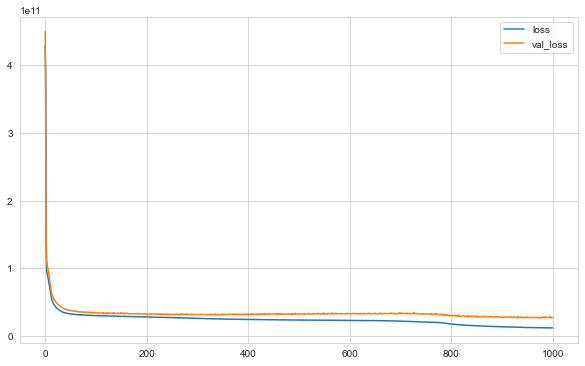

In [107]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot()

In [108]:
y_pred = model.predict(X_test_scaled)

In [109]:
y_pred2 = model.predict(X_train_scaled)

In [110]:
eval_metric(y_test, y_pred)

r2_score: 0.8657734046548746 
mae: 73345.42458674444 
mse: 16469778554.227741 
rmse: 128334.63505315992


In [111]:
eval_metric(y_train, y_pred2)

r2_score: 0.8972093406733783 
mae: 71292.24760407674 
mse: 14185303136.591022 
rmse: 119102.07024477376


In [147]:
# Görüldüğü üzere yeni learning rate ile skorlarımız oldukça iyileşti. 

### EarlyStopping

In [112]:
from tensorflow.keras.callbacks import EarlyStopping
# EarlyStopping bizim datamız artık eğitilmeyi bıraktığı anda modelin eğitimini durdurur.

In [113]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(29, activation = 'relu', input_dim = X_train.shape[1]))
model.add(Dense(29, activation = 'relu'))
model.add(Dense(16, activation = 'relu'))
model.add(Dense(8, activation = 'relu'))
model.add(Dense(4, activation = 'relu'))
model.add(Dense(1))

opt = Adam(lr = 0.003) # yukarıda denediğimiz learning_rate değerini seçtik.
model.compile(optimizer = opt, loss = 'mse')

In [114]:
early_stop = EarlyStopping(monitor = "val_loss", mode = "auto", verbose = 1, patience = 25)

# EarlyStopping fonksiyonunu early_stop değişkenine atadık.
# sonra monitor parametersine %15 lik kısmınıda dahil ederek aldığın loss değerini yani val_loss kontrol et dedik.
# verbose = 1 göster demek. yani epochlar altta çalışırken göster demek.
# patience = 25 demek : 25 satırdan sonra val_loss değerinde iyileşme olmassa eğitimi durdur demek.
# mode = auto dedik. regression da genelde auto tercih edilir. 

In [115]:
model.fit(x = X_train_scaled, y = y_train, validation_split = 0.15, batch_size = 128, epochs = 1000, callbacks = [early_stop])

# yukarıda tanımladığımız early_stop fonksiyonu baz alınarak fit et dedik.
# burda epoch 270 de eğitimi durdurmuş yani 270 kere eğitim yaptı ve durdurdu. 
# 270 den 25 satır geriye gidelim. en son val_loss değerinde en düşük skoru 245. epoch ta almış sonra skorda iyileşme olmamış
# ve 270.inci epoch ta modelin eğitim işlemini sona erdirmiş.

Epoch 1/1000
115/115 [==============================] - 1s 4ms/step - loss: 427909120000.0000 - val_loss: 448740622336.0000
Epoch 2/1000
115/115 [==============================] - 0s 3ms/step - loss: 332445351936.0000 - val_loss: 144057958400.0000
Epoch 3/1000
115/115 [==============================] - 0s 3ms/step - loss: 99303456768.0000 - val_loss: 110808956928.0000
Epoch 4/1000
115/115 [==============================] - 0s 3ms/step - loss: 92531343360.0000 - val_loss: 105130008576.0000
Epoch 5/1000
115/115 [==============================] - 0s 3ms/step - loss: 87479844864.0000 - val_loss: 99441803264.0000
Epoch 6/1000
115/115 [==============================] - 0s 3ms/step - loss: 82280185856.0000 - val_loss: 92903972864.0000
Epoch 7/1000
115/115 [==============================] - 0s 3ms/step - loss: 76423954432.0000 - val_loss: 86024331264.0000
Epoch 8/1000
115/115 [==============================] - 0s 3ms/step - loss: 70100369408.0000 - val_loss: 78446084096.0000
Epoch 9/1000
115/1

115/115 [==============================] - 0s 3ms/step - loss: 30758096896.0000 - val_loss: 35192995840.0000
Epoch 68/1000
115/115 [==============================] - 0s 2ms/step - loss: 30757226496.0000 - val_loss: 35178045440.0000
Epoch 69/1000
115/115 [==============================] - 0s 2ms/step - loss: 30673807360.0000 - val_loss: 34859257856.0000
Epoch 70/1000
115/115 [==============================] - 0s 2ms/step - loss: 30729181184.0000 - val_loss: 34995277824.0000
Epoch 71/1000
115/115 [==============================] - 0s 2ms/step - loss: 30685763584.0000 - val_loss: 35494768640.0000
Epoch 72/1000
115/115 [==============================] - 0s 2ms/step - loss: 30607896576.0000 - val_loss: 35345657856.0000
Epoch 73/1000
115/115 [==============================] - 0s 2ms/step - loss: 30608846848.0000 - val_loss: 34744803328.0000
Epoch 74/1000
115/115 [==============================] - 0s 3ms/step - loss: 30523813888.0000 - val_loss: 34708389888.0000
Epoch 75/1000
115/115 [=======

115/115 [==============================] - 0s 2ms/step - loss: 28769001472.0000 - val_loss: 33912002560.0000
Epoch 134/1000
115/115 [==============================] - 0s 2ms/step - loss: 28720472064.0000 - val_loss: 33590517760.0000
Epoch 135/1000
115/115 [==============================] - 0s 2ms/step - loss: 28732225536.0000 - val_loss: 33097553920.0000
Epoch 136/1000
115/115 [==============================] - 0s 3ms/step - loss: 28761968640.0000 - val_loss: 34763755520.0000
Epoch 137/1000
115/115 [==============================] - 0s 2ms/step - loss: 28799277056.0000 - val_loss: 33118715904.0000
Epoch 138/1000
115/115 [==============================] - 0s 2ms/step - loss: 28665090048.0000 - val_loss: 33164791808.0000
Epoch 139/1000
115/115 [==============================] - 0s 2ms/step - loss: 28727418880.0000 - val_loss: 33001660416.0000
Epoch 140/1000
115/115 [==============================] - 0s 2ms/step - loss: 28681394176.0000 - val_loss: 33309116416.0000
Epoch 141/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 27294994432.0000 - val_loss: 32763955200.0000
Epoch 200/1000
115/115 [==============================] - 0s 3ms/step - loss: 27278323712.0000 - val_loss: 31954589696.0000
Epoch 201/1000
115/115 [==============================] - 0s 3ms/step - loss: 27196071936.0000 - val_loss: 31998918656.0000
Epoch 202/1000
115/115 [==============================] - 0s 3ms/step - loss: 27156330496.0000 - val_loss: 31814631424.0000
Epoch 203/1000
115/115 [==============================] - 0s 3ms/step - loss: 27111899136.0000 - val_loss: 31751098368.0000
Epoch 204/1000
115/115 [==============================] - 0s 2ms/step - loss: 27250450432.0000 - val_loss: 31923922944.0000
Epoch 205/1000
115/115 [==============================] - 0s 3ms/step - loss: 27136059392.0000 - val_loss: 31953618944.0000
Epoch 206/1000
115/115 [==============================] - 0s 2ms/step - loss: 27193810944.0000 - val_loss: 32377696256.0000
Epoch 207/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 25806114816.0000 - val_loss: 31624538112.0000
Epoch 266/1000
115/115 [==============================] - 0s 2ms/step - loss: 25748920320.0000 - val_loss: 31615197184.0000
Epoch 267/1000
115/115 [==============================] - 0s 3ms/step - loss: 25813940224.0000 - val_loss: 31648813056.0000
Epoch 268/1000
115/115 [==============================] - 0s 2ms/step - loss: 25840840704.0000 - val_loss: 32653164544.0000
Epoch 269/1000
115/115 [==============================] - 0s 2ms/step - loss: 25739827200.0000 - val_loss: 31666839552.0000
Epoch 270/1000
115/115 [==============================] - 0s 3ms/step - loss: 25789511680.0000 - val_loss: 32146925568.0000
Epoch 270: early stopping


<AxesSubplot:>

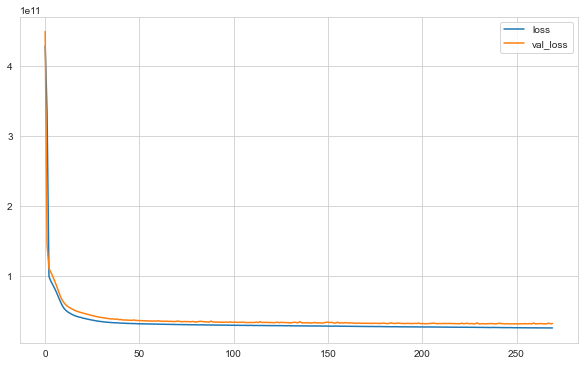

In [116]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot()

In [119]:
loss_df[(loss_df["val_loss"] == loss_df["val_loss"].min())]

,loss,val_loss
244,26199117824.000,31414331392.000


In [117]:
y_pred = model.predict(X_test_scaled)

In [118]:
eval_metric(y_test, y_pred)
# earlystop için skorlarda iyileşme olmadı çünkü burda overfit olmadığı için yapmaya gerek yoktur.
# fakat 1 tane 4 noronlu katman eklediğimiz için skorlara onun biraz faydası oldu.

r2_score: 0.7970090006147299 
mae: 99739.29476815683 
mse: 24907260739.055843 
rmse: 157820.3432357687


### Dropout

The Dropout layer randomly sets input units to 0 with a frequency of `rate`
at each step during training time, which helps prevent overfitting.

In [122]:
from tensorflow.keras.layers import Dropout
# Dropout : eğer overfit durumu varsa onu engellemek adına yapılır.

In [123]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(29, activation = 'relu', input_dim = X_train.shape[1]))
model.add(Dropout(0.2)) # 29 tane noronumla her seferinde %20 sini çalıştırma, her itersayonda rastgele %20 sini değiştir demek.
model.add(Dense(29, activation = 'relu'))
model.add(Dropout(0.2)) # 29 tane noronumla her seferinde %20 sini çalıştırma, her itersayonda rastgele %20 sini değiştir demek.
model.add(Dense(15, activation = 'relu'))
model.add(Dropout(0.2)) # 29 tane noronumla her seferinde %20 sini çalıştırma, her itersayonda rastgele %20 sini değiştir demek.
model.add(Dense(8, activation = 'relu'))
model.add(Dropout(0.2)) # 29 tane noronumla her seferinde %20 sini çalıştırma, her itersayonda rastgele %20 sini değiştir demek.
model.add(Dense(4, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(2, activation = 'relu'))
model.add(Dropout(0.1))
model.add(Dense(1))

# train ve test arasında çok fark olursa model datayı ezberlemiş demektir. işte bunu engellemek adına her katmanda noronların
# göreceği datanın %20 sini modelden saklamak demektir. biz burda her katman için koyduk. istenilen katmana konulur.

opt = Adam(lr = 0.003)
model.compile(optimizer = opt, loss = 'mse')

In [124]:
early_stop = EarlyStopping(monitor = "val_loss", mode = "auto", verbose = 1, patience = 25)

In [125]:
model.fit(x = X_train_scaled, y = y_train, validation_split = 0.15, batch_size = 128, epochs = 1000, callbacks = [early_stop])

Epoch 1/1000
115/115 [==============================] - 1s 5ms/step - loss: 427137204224.0000 - val_loss: 439190126592.0000
Epoch 2/1000
115/115 [==============================] - 0s 3ms/step - loss: 255706546176.0000 - val_loss: 136740929536.0000
Epoch 3/1000
115/115 [==============================] - 0s 4ms/step - loss: 178510823424.0000 - val_loss: 130968952832.0000
Epoch 4/1000
115/115 [==============================] - 0s 4ms/step - loss: 166948225024.0000 - val_loss: 113623990272.0000
Epoch 5/1000
115/115 [==============================] - 0s 4ms/step - loss: 161178468352.0000 - val_loss: 107981750272.0000
Epoch 6/1000
115/115 [==============================] - 0s 3ms/step - loss: 152896454656.0000 - val_loss: 103225868288.0000
Epoch 7/1000
115/115 [==============================] - 0s 4ms/step - loss: 144780984320.0000 - val_loss: 91847540736.0000
Epoch 8/1000
115/115 [==============================] - 0s 3ms/step - loss: 140403474432.0000 - val_loss: 83132989440.0000
Epoch 9/10

115/115 [==============================] - 0s 3ms/step - loss: 121582755840.0000 - val_loss: 50826100736.0000
Epoch 68/1000
115/115 [==============================] - 0s 3ms/step - loss: 118782304256.0000 - val_loss: 54649774080.0000
Epoch 69/1000
115/115 [==============================] - 0s 3ms/step - loss: 124417286144.0000 - val_loss: 59311538176.0000
Epoch 70/1000
115/115 [==============================] - 0s 3ms/step - loss: 116167483392.0000 - val_loss: 53792587776.0000
Epoch 71/1000
115/115 [==============================] - 0s 3ms/step - loss: 131554500608.0000 - val_loss: 50133598208.0000
Epoch 72/1000
115/115 [==============================] - 0s 3ms/step - loss: 119462887424.0000 - val_loss: 47221837824.0000
Epoch 73/1000
115/115 [==============================] - 0s 3ms/step - loss: 125078233088.0000 - val_loss: 55130566656.0000
Epoch 74/1000
115/115 [==============================] - 0s 3ms/step - loss: 120698183680.0000 - val_loss: 62138122240.0000
Epoch 75/1000
115/115 

<AxesSubplot:>

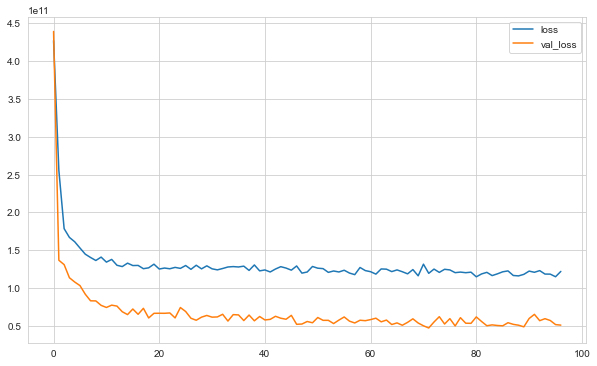

In [126]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot()
# loss ve val_loss arasında farkların biraz açıldığı görüldü. 97 tane epoch yaptı. 

In [129]:
y_pred = model.predict(X_test_scaled)

In [130]:
eval_metric(y_test, y_pred)
# hata skorlarını düşürdü. yani dropout çok faydalı olmadı. ama datada overfit olsaydı oldukça faydalı olacaktı.

r2_score: 0.6355138056695536 
mae: 132762.68493923612 
mse: 44722932078.107544 
rmse: 211477.97066859598


### Noron sayısını arttırarak skorlara bakalım : 

In [132]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(45, activation = 'relu', input_dim = X_train.shape[1])) # 29 un 3/2 katını verdik.
model.add(Dense(29, activation = 'relu'))
model.add(Dense(16, activation = 'relu'))
model.add(Dense(8, activation = 'relu'))
model.add(Dense(4, activation = 'relu'))
model.add(Dense(2, activation = 'relu'))
model.add(Dense(1))

opt = Adam(lr = 0.003) # yukarıda denediğimiz learning_rate değerini seçtik.
model.compile(optimizer = opt, loss = 'mse')

In [135]:
early_stop = EarlyStopping(monitor = "val_loss", mode = "auto", verbose = 1, patience = 32)

In [137]:
model.fit(x = X_train_scaled, y = y_train, validation_split = 0.15, batch_size = 128, epochs = 1000, callbacks = [early_stop])

Epoch 1/1000
115/115 [==============================] - 1s 4ms/step - loss: 426194337792.0000 - val_loss: 430676869120.0000
Epoch 2/1000
115/115 [==============================] - 0s 3ms/step - loss: 189004513280.0000 - val_loss: 111618801664.0000
Epoch 3/1000
115/115 [==============================] - 0s 3ms/step - loss: 91911438336.0000 - val_loss: 102717153280.0000
Epoch 4/1000
115/115 [==============================] - 0s 3ms/step - loss: 84011548672.0000 - val_loss: 93277085696.0000
Epoch 5/1000
115/115 [==============================] - 0s 3ms/step - loss: 75167014912.0000 - val_loss: 82516410368.0000
Epoch 6/1000
115/115 [==============================] - 0s 3ms/step - loss: 65498337280.0000 - val_loss: 71609614336.0000
Epoch 7/1000
115/115 [==============================] - 0s 3ms/step - loss: 56952844288.0000 - val_loss: 63255613440.0000
Epoch 8/1000
115/115 [==============================] - 0s 3ms/step - loss: 51465252864.0000 - val_loss: 58361810944.0000
Epoch 9/1000
115/11

115/115 [==============================] - 0s 3ms/step - loss: 29370019840.0000 - val_loss: 34287982592.0000
Epoch 68/1000
115/115 [==============================] - 0s 3ms/step - loss: 29455108096.0000 - val_loss: 34040741888.0000
Epoch 69/1000
115/115 [==============================] - 0s 3ms/step - loss: 29402245120.0000 - val_loss: 33492924416.0000
Epoch 70/1000
115/115 [==============================] - 0s 4ms/step - loss: 29457784832.0000 - val_loss: 33908510720.0000
Epoch 71/1000
115/115 [==============================] - 0s 3ms/step - loss: 29396357120.0000 - val_loss: 34317860864.0000
Epoch 72/1000
115/115 [==============================] - 0s 4ms/step - loss: 29278803968.0000 - val_loss: 34037463040.0000
Epoch 73/1000
115/115 [==============================] - 0s 3ms/step - loss: 29406758912.0000 - val_loss: 33432000512.0000
Epoch 74/1000
115/115 [==============================] - 0s 3ms/step - loss: 29263398912.0000 - val_loss: 33400780800.0000
Epoch 75/1000
115/115 [=======

115/115 [==============================] - 0s 3ms/step - loss: 26775570432.0000 - val_loss: 32972830720.0000
Epoch 134/1000
115/115 [==============================] - 0s 3ms/step - loss: 26752624640.0000 - val_loss: 33218537472.0000
Epoch 135/1000
115/115 [==============================] - 0s 3ms/step - loss: 26731577344.0000 - val_loss: 31833980928.0000
Epoch 136/1000
115/115 [==============================] - 0s 3ms/step - loss: 26685665280.0000 - val_loss: 33213706240.0000
Epoch 137/1000
115/115 [==============================] - 0s 3ms/step - loss: 26828771328.0000 - val_loss: 31859587072.0000
Epoch 138/1000
115/115 [==============================] - 0s 3ms/step - loss: 26679799808.0000 - val_loss: 31737182208.0000
Epoch 139/1000
115/115 [==============================] - 0s 3ms/step - loss: 26704635904.0000 - val_loss: 32038518784.0000
Epoch 140/1000
115/115 [==============================] - 0s 3ms/step - loss: 26597058560.0000 - val_loss: 31620104192.0000
Epoch 141/1000
115/115 

In [136]:
def train_val(model, X_train, y_train, X_test, y_test):
    
    y_pred = model.predict(X_test)
    y_train_pred = model.predict(X_train)
    
    scores = {"train": {"R2" : r2_score(y_train, y_train_pred),
    "mae" : mean_absolute_error(y_train, y_train_pred),
    "mse" : mean_squared_error(y_train, y_train_pred),                          
    "rmse" : np.sqrt(mean_squared_error(y_train, y_train_pred))},
    
    "test": {"R2" : r2_score(y_test, y_pred),
    "mae" : mean_absolute_error(y_test, y_pred),
    "mse" : mean_squared_error(y_test, y_pred),
    "rmse" : np.sqrt(mean_squared_error(y_test, y_pred))}}
    
    return pd.DataFrame(scores)

In [138]:
train_val(model, X_train_scaled, y_train, X_test_scaled, y_test)
# skorlar iyileşmedi. noron sayısını arttırmak işe yaramadı.

,train,test
R2,0.815,0.805
mae,100001.073,97135.932
mse,25500857267.481,23881654206.001
rmse,159689.878,154536.902


### Early_Stop Kullanmadan Noron sayısı artışı : 

In [139]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(45, activation = 'relu', input_dim = X_train.shape[1])) # 29 un 3/2 katını verdik.
model.add(Dense(29, activation = 'relu'))
model.add(Dense(16, activation = 'relu'))
model.add(Dense(8, activation = 'relu'))
model.add(Dense(4, activation = 'relu'))
model.add(Dense(2, activation = 'relu'))
model.add(Dense(1))

opt = Adam(lr = 0.003) # yukarıda denediğimiz learning_rate değerini seçtik.
model.compile(optimizer = opt, loss = 'mse')

In [140]:
model.fit(x = X_train_scaled, y = y_train, validation_split = 0.15, batch_size = 128, epochs = 1000)

Epoch 1/1000
115/115 [==============================] - 1s 4ms/step - loss: 426194337792.0000 - val_loss: 430676869120.0000
Epoch 2/1000
115/115 [==============================] - 0s 3ms/step - loss: 189004513280.0000 - val_loss: 111618801664.0000
Epoch 3/1000
115/115 [==============================] - 0s 3ms/step - loss: 91911438336.0000 - val_loss: 102717153280.0000
Epoch 4/1000
115/115 [==============================] - 0s 3ms/step - loss: 84011548672.0000 - val_loss: 93277085696.0000
Epoch 5/1000
115/115 [==============================] - 0s 3ms/step - loss: 75167014912.0000 - val_loss: 82516410368.0000
Epoch 6/1000
115/115 [==============================] - 0s 3ms/step - loss: 65498337280.0000 - val_loss: 71609614336.0000
Epoch 7/1000
115/115 [==============================] - 0s 3ms/step - loss: 56952844288.0000 - val_loss: 63255613440.0000
Epoch 8/1000
115/115 [==============================] - 0s 3ms/step - loss: 51465252864.0000 - val_loss: 58361810944.0000
Epoch 9/1000
115/11

115/115 [==============================] - 0s 3ms/step - loss: 29370019840.0000 - val_loss: 34287982592.0000
Epoch 68/1000
115/115 [==============================] - 0s 3ms/step - loss: 29455108096.0000 - val_loss: 34040741888.0000
Epoch 69/1000
115/115 [==============================] - 0s 2ms/step - loss: 29402245120.0000 - val_loss: 33492924416.0000
Epoch 70/1000
115/115 [==============================] - 0s 3ms/step - loss: 29457784832.0000 - val_loss: 33908510720.0000
Epoch 71/1000
115/115 [==============================] - 0s 3ms/step - loss: 29396357120.0000 - val_loss: 34317860864.0000
Epoch 72/1000
115/115 [==============================] - 0s 2ms/step - loss: 29278803968.0000 - val_loss: 34037463040.0000
Epoch 73/1000
115/115 [==============================] - 0s 2ms/step - loss: 29406758912.0000 - val_loss: 33432000512.0000
Epoch 74/1000
115/115 [==============================] - 0s 3ms/step - loss: 29263398912.0000 - val_loss: 33400780800.0000
Epoch 75/1000
115/115 [=======

115/115 [==============================] - 0s 3ms/step - loss: 26775570432.0000 - val_loss: 32972830720.0000
Epoch 134/1000
115/115 [==============================] - 0s 3ms/step - loss: 26752624640.0000 - val_loss: 33218537472.0000
Epoch 135/1000
115/115 [==============================] - 0s 2ms/step - loss: 26731577344.0000 - val_loss: 31833980928.0000
Epoch 136/1000
115/115 [==============================] - 0s 3ms/step - loss: 26685665280.0000 - val_loss: 33213706240.0000
Epoch 137/1000
115/115 [==============================] - 0s 3ms/step - loss: 26828771328.0000 - val_loss: 31859587072.0000
Epoch 138/1000
115/115 [==============================] - 0s 3ms/step - loss: 26679799808.0000 - val_loss: 31737182208.0000
Epoch 139/1000
115/115 [==============================] - 0s 3ms/step - loss: 26704635904.0000 - val_loss: 32038518784.0000
Epoch 140/1000
115/115 [==============================] - 0s 3ms/step - loss: 26597058560.0000 - val_loss: 31620104192.0000
Epoch 141/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 24824461312.0000 - val_loss: 32544161792.0000
Epoch 200/1000
115/115 [==============================] - 0s 2ms/step - loss: 24680814592.0000 - val_loss: 31630530560.0000
Epoch 201/1000
115/115 [==============================] - 0s 3ms/step - loss: 24729055232.0000 - val_loss: 31851104256.0000
Epoch 202/1000
115/115 [==============================] - 0s 3ms/step - loss: 24554305536.0000 - val_loss: 31998054400.0000
Epoch 203/1000
115/115 [==============================] - 0s 2ms/step - loss: 24573253632.0000 - val_loss: 31462471680.0000
Epoch 204/1000
115/115 [==============================] - 0s 2ms/step - loss: 24849666048.0000 - val_loss: 31799465984.0000
Epoch 205/1000
115/115 [==============================] - 0s 3ms/step - loss: 24556865536.0000 - val_loss: 32005818368.0000
Epoch 206/1000
115/115 [==============================] - 0s 2ms/step - loss: 24661923840.0000 - val_loss: 32939862016.0000
Epoch 207/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 21651818496.0000 - val_loss: 31606679552.0000
Epoch 266/1000
115/115 [==============================] - 0s 2ms/step - loss: 21513924608.0000 - val_loss: 31216001024.0000
Epoch 267/1000
115/115 [==============================] - 0s 2ms/step - loss: 21480323072.0000 - val_loss: 31172857856.0000
Epoch 268/1000
115/115 [==============================] - 0s 3ms/step - loss: 21206444032.0000 - val_loss: 31445557248.0000
Epoch 269/1000
115/115 [==============================] - 0s 2ms/step - loss: 21120819200.0000 - val_loss: 30294370304.0000
Epoch 270/1000
115/115 [==============================] - 0s 2ms/step - loss: 21140226048.0000 - val_loss: 30748307456.0000
Epoch 271/1000
115/115 [==============================] - 0s 2ms/step - loss: 20882997248.0000 - val_loss: 30424104960.0000
Epoch 272/1000
115/115 [==============================] - 0s 2ms/step - loss: 20851222528.0000 - val_loss: 31169724416.0000
Epoch 273/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 16743825408.0000 - val_loss: 27956899840.0000
Epoch 332/1000
115/115 [==============================] - 0s 2ms/step - loss: 16733172736.0000 - val_loss: 26630318080.0000
Epoch 333/1000
115/115 [==============================] - 0s 3ms/step - loss: 16893651968.0000 - val_loss: 26561196032.0000
Epoch 334/1000
115/115 [==============================] - 0s 2ms/step - loss: 16775561216.0000 - val_loss: 26602614784.0000
Epoch 335/1000
115/115 [==============================] - 0s 3ms/step - loss: 16792466432.0000 - val_loss: 27118848000.0000
Epoch 336/1000
115/115 [==============================] - 0s 2ms/step - loss: 16821358592.0000 - val_loss: 26961152000.0000
Epoch 337/1000
115/115 [==============================] - 0s 2ms/step - loss: 16768960512.0000 - val_loss: 28187217920.0000
Epoch 338/1000
115/115 [==============================] - 0s 2ms/step - loss: 16821317632.0000 - val_loss: 26454781952.0000
Epoch 339/1000
115/115 

115/115 [==============================] - 0s 4ms/step - loss: 15473734656.0000 - val_loss: 26452193280.0000
Epoch 398/1000
115/115 [==============================] - 1s 4ms/step - loss: 15310848000.0000 - val_loss: 26503587840.0000
Epoch 399/1000
115/115 [==============================] - 0s 4ms/step - loss: 15172217856.0000 - val_loss: 26517587968.0000
Epoch 400/1000
115/115 [==============================] - 0s 3ms/step - loss: 15196806144.0000 - val_loss: 26204667904.0000
Epoch 401/1000
115/115 [==============================] - 0s 3ms/step - loss: 15107463168.0000 - val_loss: 25935081472.0000
Epoch 402/1000
115/115 [==============================] - 0s 3ms/step - loss: 15040471040.0000 - val_loss: 27336114176.0000
Epoch 403/1000
115/115 [==============================] - 0s 3ms/step - loss: 15127993344.0000 - val_loss: 26134482944.0000
Epoch 404/1000
115/115 [==============================] - 0s 4ms/step - loss: 15062591488.0000 - val_loss: 26127157248.0000
Epoch 405/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 13772940288.0000 - val_loss: 25652133888.0000
Epoch 464/1000
115/115 [==============================] - 0s 3ms/step - loss: 13469277184.0000 - val_loss: 25318537216.0000
Epoch 465/1000
115/115 [==============================] - 0s 4ms/step - loss: 13466280960.0000 - val_loss: 25880354816.0000
Epoch 466/1000
115/115 [==============================] - 0s 3ms/step - loss: 13404760064.0000 - val_loss: 25552087040.0000
Epoch 467/1000
115/115 [==============================] - 0s 3ms/step - loss: 13330295808.0000 - val_loss: 25981657088.0000
Epoch 468/1000
115/115 [==============================] - 0s 3ms/step - loss: 13625607168.0000 - val_loss: 26565044224.0000
Epoch 469/1000
115/115 [==============================] - 0s 3ms/step - loss: 13352687616.0000 - val_loss: 26108782592.0000
Epoch 470/1000
115/115 [==============================] - 0s 3ms/step - loss: 13679187968.0000 - val_loss: 25944852480.0000
Epoch 471/1000
115/115 

115/115 [==============================] - 0s 2ms/step - loss: 11839448064.0000 - val_loss: 23559575552.0000
Epoch 530/1000
115/115 [==============================] - 0s 3ms/step - loss: 11924649984.0000 - val_loss: 24150142976.0000
Epoch 531/1000
115/115 [==============================] - 0s 3ms/step - loss: 11905874944.0000 - val_loss: 23505784832.0000
Epoch 532/1000
115/115 [==============================] - 0s 3ms/step - loss: 11750559744.0000 - val_loss: 24505118720.0000
Epoch 533/1000
115/115 [==============================] - 0s 3ms/step - loss: 11696131072.0000 - val_loss: 24622757888.0000
Epoch 534/1000
115/115 [==============================] - 0s 3ms/step - loss: 11805775872.0000 - val_loss: 24723511296.0000
Epoch 535/1000
115/115 [==============================] - 0s 3ms/step - loss: 11876535296.0000 - val_loss: 23673118720.0000
Epoch 536/1000
115/115 [==============================] - 0s 3ms/step - loss: 11847774208.0000 - val_loss: 24003760128.0000
Epoch 537/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 10865967104.0000 - val_loss: 24897380352.0000
Epoch 596/1000
115/115 [==============================] - 0s 3ms/step - loss: 11073822720.0000 - val_loss: 24420061184.0000
Epoch 597/1000
115/115 [==============================] - 0s 3ms/step - loss: 10860285952.0000 - val_loss: 24999843840.0000
Epoch 598/1000
115/115 [==============================] - 0s 3ms/step - loss: 10825618432.0000 - val_loss: 23884083200.0000
Epoch 599/1000
115/115 [==============================] - 0s 3ms/step - loss: 10792221696.0000 - val_loss: 25366061056.0000
Epoch 600/1000
115/115 [==============================] - 0s 3ms/step - loss: 10792558592.0000 - val_loss: 24509210624.0000
Epoch 601/1000
115/115 [==============================] - 0s 3ms/step - loss: 10809907200.0000 - val_loss: 26529103872.0000
Epoch 602/1000
115/115 [==============================] - 0s 3ms/step - loss: 10724265984.0000 - val_loss: 23545462784.0000
Epoch 603/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 10317619200.0000 - val_loss: 23285651456.0000
Epoch 662/1000
115/115 [==============================] - 0s 3ms/step - loss: 10440481792.0000 - val_loss: 25290586112.0000
Epoch 663/1000
115/115 [==============================] - 0s 3ms/step - loss: 10348328960.0000 - val_loss: 24985266176.0000
Epoch 664/1000
115/115 [==============================] - 0s 3ms/step - loss: 10387104768.0000 - val_loss: 24687734784.0000
Epoch 665/1000
115/115 [==============================] - 0s 3ms/step - loss: 10469830656.0000 - val_loss: 24539643904.0000
Epoch 666/1000
115/115 [==============================] - 0s 3ms/step - loss: 10310893568.0000 - val_loss: 24261486592.0000
Epoch 667/1000
115/115 [==============================] - 0s 3ms/step - loss: 10279242752.0000 - val_loss: 24431278080.0000
Epoch 668/1000
115/115 [==============================] - 0s 3ms/step - loss: 10630676480.0000 - val_loss: 25072867328.0000
Epoch 669/1000
115/115 

115/115 [==============================] - 0s 3ms/step - loss: 9764023296.0000 - val_loss: 25123000320.0000
Epoch 728/1000
115/115 [==============================] - 0s 3ms/step - loss: 9689848832.0000 - val_loss: 23810746368.0000
Epoch 729/1000
115/115 [==============================] - 0s 3ms/step - loss: 9560230912.0000 - val_loss: 23260997632.0000
Epoch 730/1000
115/115 [==============================] - 0s 3ms/step - loss: 9797949440.0000 - val_loss: 23441227776.0000
Epoch 731/1000
115/115 [==============================] - 0s 2ms/step - loss: 9515951104.0000 - val_loss: 24890970112.0000
Epoch 732/1000
115/115 [==============================] - 0s 3ms/step - loss: 9516810240.0000 - val_loss: 22536257536.0000
Epoch 733/1000
115/115 [==============================] - 0s 3ms/step - loss: 9528545280.0000 - val_loss: 23272816640.0000
Epoch 734/1000
115/115 [==============================] - 0s 3ms/step - loss: 9467101184.0000 - val_loss: 23006105600.0000
Epoch 735/1000
115/115 [=======

115/115 [==============================] - 0s 3ms/step - loss: 9085454336.0000 - val_loss: 24229685248.0000
Epoch 794/1000
115/115 [==============================] - 0s 3ms/step - loss: 9030002688.0000 - val_loss: 23190245376.0000
Epoch 795/1000
115/115 [==============================] - 0s 3ms/step - loss: 8940384256.0000 - val_loss: 23798917120.0000
Epoch 796/1000
115/115 [==============================] - 0s 3ms/step - loss: 8935435264.0000 - val_loss: 22543230976.0000
Epoch 797/1000
115/115 [==============================] - 0s 3ms/step - loss: 8812916736.0000 - val_loss: 23715661824.0000
Epoch 798/1000
115/115 [==============================] - 0s 3ms/step - loss: 8889363456.0000 - val_loss: 24054276096.0000
Epoch 799/1000
115/115 [==============================] - 0s 3ms/step - loss: 8924840960.0000 - val_loss: 24722325504.0000
Epoch 800/1000
115/115 [==============================] - 0s 3ms/step - loss: 8933108736.0000 - val_loss: 23856234496.0000
Epoch 801/1000
115/115 [=======

Epoch 860/1000
115/115 [==============================] - 0s 3ms/step - loss: 8636480512.0000 - val_loss: 24591323136.0000
Epoch 861/1000
115/115 [==============================] - 0s 3ms/step - loss: 8549902848.0000 - val_loss: 24119420928.0000
Epoch 862/1000
115/115 [==============================] - 0s 3ms/step - loss: 8602726400.0000 - val_loss: 25385781248.0000
Epoch 863/1000
115/115 [==============================] - 0s 3ms/step - loss: 8699161600.0000 - val_loss: 24058875904.0000
Epoch 864/1000
115/115 [==============================] - 0s 3ms/step - loss: 8586618880.0000 - val_loss: 23292307456.0000
Epoch 865/1000
115/115 [==============================] - 0s 3ms/step - loss: 8557134848.0000 - val_loss: 25314359296.0000
Epoch 866/1000
115/115 [==============================] - 0s 3ms/step - loss: 8751036416.0000 - val_loss: 23467753472.0000
Epoch 867/1000
115/115 [==============================] - 0s 3ms/step - loss: 8528954880.0000 - val_loss: 25359589376.0000
Epoch 868/1000
1

115/115 [==============================] - 1s 5ms/step - loss: 8345114112.0000 - val_loss: 25014599680.0000
Epoch 927/1000
115/115 [==============================] - 1s 5ms/step - loss: 8314892288.0000 - val_loss: 25275881472.0000
Epoch 928/1000
115/115 [==============================] - 0s 4ms/step - loss: 8442357760.0000 - val_loss: 24560506880.0000
Epoch 929/1000
115/115 [==============================] - 0s 4ms/step - loss: 8312496640.0000 - val_loss: 24826351616.0000
Epoch 930/1000
115/115 [==============================] - 1s 5ms/step - loss: 8440464384.0000 - val_loss: 24511770624.0000
Epoch 931/1000
115/115 [==============================] - 0s 4ms/step - loss: 8270206464.0000 - val_loss: 24373258240.0000
Epoch 932/1000
115/115 [==============================] - 1s 5ms/step - loss: 8283120128.0000 - val_loss: 25890926592.0000
Epoch 933/1000
115/115 [==============================] - 0s 4ms/step - loss: 8446093312.0000 - val_loss: 25397862400.0000
Epoch 934/1000
115/115 [=======

Epoch 993/1000
115/115 [==============================] - 0s 3ms/step - loss: 8273972224.0000 - val_loss: 24573460480.0000
Epoch 994/1000
115/115 [==============================] - 0s 3ms/step - loss: 8017117696.0000 - val_loss: 27087908864.0000
Epoch 995/1000
115/115 [==============================] - 0s 3ms/step - loss: 8202665472.0000 - val_loss: 24245676032.0000
Epoch 996/1000
115/115 [==============================] - 0s 4ms/step - loss: 8196590080.0000 - val_loss: 24890232832.0000
Epoch 997/1000
115/115 [==============================] - 0s 3ms/step - loss: 7991978496.0000 - val_loss: 25540214784.0000
Epoch 998/1000
115/115 [==============================] - 0s 4ms/step - loss: 8236302848.0000 - val_loss: 24661495808.0000
Epoch 999/1000
115/115 [==============================] - 0s 3ms/step - loss: 8066806272.0000 - val_loss: 26487515136.0000
Epoch 1000/1000
115/115 [==============================] - 0s 3ms/step - loss: 8047037952.0000 - val_loss: 26279022592.0000


In [141]:
train_val(model, X_train_scaled, y_train, X_test_scaled, y_test)

,train,test
R2,0.922,0.832
mae,63904.393,75000.074
mse,10743067984.974,20637522699.690
rmse,103648.772,143657.658


#### En güzel skorları eraly stop yapmadan, dropout yapmadan, noron sayısına future sayımızın adedi kadar sayı vererek ilk katmandan başlayarak aldık.


## Saving Final Model and Scaler

In [166]:
import pickle
pickle.dump(scaler, open("scaler_kc_house", 'wb'))
# scaler başka yerde kulanmak adına dump ettik.

In [167]:
tf.random.set_seed(seed)

model = Sequential()

model.add(Dense(29, activation = 'relu', input_dim = X_train.shape[1]))
model.add(Dense(29, activation = 'relu'))
model.add(Dense(15, activation = 'relu'))
model.add(Dense(8, activation = 'relu'))
model.add(Dense(1))

opt = Adam(lr = 0.003) # Adam fonksiyonuna lr değeri atadık
model.compile(optimizer = opt , loss = 'mse')

In [ ]:
#early_stop = EarlyStopping(monitor = "val_loss", mode = "auto", verbose = 1, patience = 25)

In [168]:
model.fit(x = X_train_scaled, y = y_train, validation_data = (X_test_scaled, y_test), batch_size = 128, epochs = 1000,
         # callbacks = [early_stop]
         )
# validation_split seçersek oran veririz yani şu kadarlık bir kısmının validation için ayır. sonra ayırdığını da train olarak 
# aldığımı loss skoruna ekleyip val_loss skorunu göster demektir.

# validation_data seçersek : tüm train data modelini epoch kadar batch_size satırı adedince eğittik.
# sonra test datasını da içine sokarak train ve test datası için loss skoru al demektir.

Epoch 1/1000
135/135 [==============================] - 1s 4ms/step - loss: 431055732736.0000 - val_loss: 401825595392.0000
Epoch 2/1000
135/135 [==============================] - 0s 3ms/step - loss: 331376394240.0000 - val_loss: 131651510272.0000
Epoch 3/1000
135/135 [==============================] - 0s 3ms/step - loss: 104493408256.0000 - val_loss: 84452089856.0000
Epoch 4/1000
135/135 [==============================] - 0s 3ms/step - loss: 95428517888.0000 - val_loss: 79712780288.0000
Epoch 5/1000
135/135 [==============================] - 0s 3ms/step - loss: 90204250112.0000 - val_loss: 74815168512.0000
Epoch 6/1000
135/135 [==============================] - 0s 3ms/step - loss: 84458594304.0000 - val_loss: 69376557056.0000
Epoch 7/1000
135/135 [==============================] - 0s 3ms/step - loss: 78053990400.0000 - val_loss: 63587725312.0000
Epoch 8/1000
135/135 [==============================] - 0s 3ms/step - loss: 71231217664.0000 - val_loss: 57540681728.0000
Epoch 9/1000
135/13

135/135 [==============================] - 0s 3ms/step - loss: 30746783744.0000 - val_loss: 27986460672.0000
Epoch 134/1000
135/135 [==============================] - 0s 3ms/step - loss: 30750144512.0000 - val_loss: 27977699328.0000
Epoch 135/1000
135/135 [==============================] - 0s 3ms/step - loss: 30676819968.0000 - val_loss: 27937079296.0000
Epoch 136/1000
135/135 [==============================] - 0s 2ms/step - loss: 30708594688.0000 - val_loss: 28002643968.0000
Epoch 137/1000
135/135 [==============================] - 0s 3ms/step - loss: 30660222976.0000 - val_loss: 28670932992.0000
Epoch 138/1000
135/135 [==============================] - 0s 2ms/step - loss: 30631819264.0000 - val_loss: 27814629376.0000
Epoch 139/1000
135/135 [==============================] - 0s 3ms/step - loss: 30604933120.0000 - val_loss: 28113133568.0000
Epoch 140/1000
135/135 [==============================] - 0s 2ms/step - loss: 30613946368.0000 - val_loss: 27767670784.0000
Epoch 141/1000
135/135 

135/135 [==============================] - 0s 3ms/step - loss: 29122764800.0000 - val_loss: 25616431104.0000
Epoch 266/1000
135/135 [==============================] - 0s 2ms/step - loss: 29062948864.0000 - val_loss: 25629540352.0000
Epoch 267/1000
135/135 [==============================] - 0s 3ms/step - loss: 29041707008.0000 - val_loss: 25704079360.0000
Epoch 268/1000
135/135 [==============================] - 0s 2ms/step - loss: 29127305216.0000 - val_loss: 25550350336.0000
Epoch 269/1000
135/135 [==============================] - 0s 3ms/step - loss: 29005955072.0000 - val_loss: 25583136768.0000
Epoch 270/1000
135/135 [==============================] - 0s 2ms/step - loss: 29068134400.0000 - val_loss: 25666189312.0000
Epoch 271/1000
135/135 [==============================] - 0s 2ms/step - loss: 29046155264.0000 - val_loss: 25613676544.0000
Epoch 272/1000
135/135 [==============================] - 0s 2ms/step - loss: 29022883840.0000 - val_loss: 25989859328.0000
Epoch 273/1000
135/135 

135/135 [==============================] - 0s 2ms/step - loss: 27507777536.0000 - val_loss: 24140390400.0000
Epoch 398/1000
135/135 [==============================] - 0s 2ms/step - loss: 27566770176.0000 - val_loss: 23979724800.0000
Epoch 399/1000
135/135 [==============================] - 0s 2ms/step - loss: 27541960704.0000 - val_loss: 23980863488.0000
Epoch 400/1000
135/135 [==============================] - 0s 2ms/step - loss: 27656587264.0000 - val_loss: 24010491904.0000
Epoch 401/1000
135/135 [==============================] - 0s 2ms/step - loss: 27520948224.0000 - val_loss: 23881355264.0000
Epoch 402/1000
135/135 [==============================] - 0s 2ms/step - loss: 27485245440.0000 - val_loss: 23928950784.0000
Epoch 403/1000
135/135 [==============================] - 0s 2ms/step - loss: 27591700480.0000 - val_loss: 23961401344.0000
Epoch 404/1000
135/135 [==============================] - 0s 2ms/step - loss: 27489456128.0000 - val_loss: 24021366784.0000
Epoch 405/1000
135/135 

135/135 [==============================] - 0s 2ms/step - loss: 26554007552.0000 - val_loss: 23055734784.0000
Epoch 530/1000
135/135 [==============================] - 0s 2ms/step - loss: 26545915904.0000 - val_loss: 23041374208.0000
Epoch 531/1000
135/135 [==============================] - 0s 2ms/step - loss: 26540761088.0000 - val_loss: 23080120320.0000
Epoch 532/1000
135/135 [==============================] - 0s 2ms/step - loss: 26531522560.0000 - val_loss: 23164114944.0000
Epoch 533/1000
135/135 [==============================] - 0s 3ms/step - loss: 26491115520.0000 - val_loss: 23361423360.0000
Epoch 534/1000
135/135 [==============================] - 0s 3ms/step - loss: 26390130688.0000 - val_loss: 23713675264.0000
Epoch 535/1000
135/135 [==============================] - 0s 3ms/step - loss: 26495662080.0000 - val_loss: 23114524672.0000
Epoch 536/1000
135/135 [==============================] - 0s 3ms/step - loss: 26482737152.0000 - val_loss: 23107233792.0000
Epoch 537/1000
135/135 

135/135 [==============================] - 0s 3ms/step - loss: 26178920448.0000 - val_loss: 22677608448.0000
Epoch 662/1000
135/135 [==============================] - 0s 3ms/step - loss: 26178072576.0000 - val_loss: 22628968448.0000
Epoch 663/1000
135/135 [==============================] - 0s 3ms/step - loss: 26146260992.0000 - val_loss: 22609790976.0000
Epoch 664/1000
135/135 [==============================] - 0s 2ms/step - loss: 26145908736.0000 - val_loss: 22681022464.0000
Epoch 665/1000
135/135 [==============================] - 0s 3ms/step - loss: 26053642240.0000 - val_loss: 23193286656.0000
Epoch 666/1000
135/135 [==============================] - 0s 2ms/step - loss: 26103314432.0000 - val_loss: 22663010304.0000
Epoch 667/1000
135/135 [==============================] - 0s 2ms/step - loss: 26150944768.0000 - val_loss: 22651508736.0000
Epoch 668/1000
135/135 [==============================] - 0s 2ms/step - loss: 26095319040.0000 - val_loss: 22723317760.0000
Epoch 669/1000
135/135 

135/135 [==============================] - 0s 2ms/step - loss: 25730945024.0000 - val_loss: 23228000256.0000
Epoch 794/1000
135/135 [==============================] - 0s 3ms/step - loss: 25821718528.0000 - val_loss: 22354278400.0000
Epoch 795/1000
135/135 [==============================] - 0s 2ms/step - loss: 25751556096.0000 - val_loss: 22381426688.0000
Epoch 796/1000
135/135 [==============================] - 0s 2ms/step - loss: 25720322048.0000 - val_loss: 22303365120.0000
Epoch 797/1000
135/135 [==============================] - 0s 3ms/step - loss: 25797740544.0000 - val_loss: 22280187904.0000
Epoch 798/1000
135/135 [==============================] - 0s 3ms/step - loss: 25754550272.0000 - val_loss: 22301962240.0000
Epoch 799/1000
135/135 [==============================] - 0s 3ms/step - loss: 25870710784.0000 - val_loss: 22280323072.0000
Epoch 800/1000
135/135 [==============================] - 0s 2ms/step - loss: 25708433408.0000 - val_loss: 22404397056.0000
Epoch 801/1000
135/135 

135/135 [==============================] - 0s 3ms/step - loss: 25590163456.0000 - val_loss: 22131343360.0000
Epoch 926/1000
135/135 [==============================] - 0s 2ms/step - loss: 25526505472.0000 - val_loss: 22163154944.0000
Epoch 927/1000
135/135 [==============================] - 0s 3ms/step - loss: 25550026752.0000 - val_loss: 22163197952.0000
Epoch 928/1000
135/135 [==============================] - 0s 2ms/step - loss: 25527857152.0000 - val_loss: 22244773888.0000
Epoch 929/1000
135/135 [==============================] - 0s 3ms/step - loss: 25551652864.0000 - val_loss: 22305570816.0000
Epoch 930/1000
135/135 [==============================] - 0s 3ms/step - loss: 25585262592.0000 - val_loss: 22229991424.0000
Epoch 931/1000
135/135 [==============================] - 0s 3ms/step - loss: 25689257984.0000 - val_loss: 22307700736.0000
Epoch 932/1000
135/135 [==============================] - 0s 3ms/step - loss: 25696559104.0000 - val_loss: 22120564736.0000
Epoch 933/1000
135/135 

<AxesSubplot:>

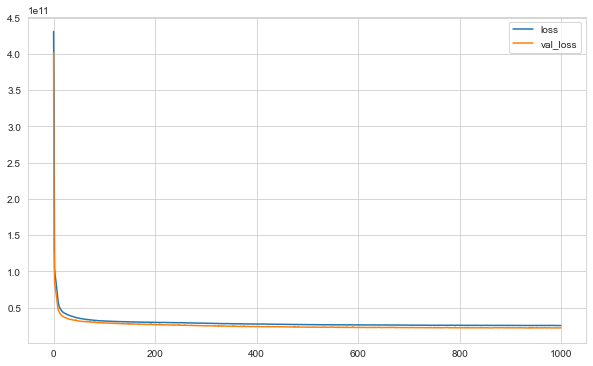

In [169]:
loss_df = pd.DataFrame(model.history.history)
loss_df.plot()

In [170]:
y_pred = model.predict(X_test_scaled)

In [171]:
eval_metric(y_test, y_pred)
# ortalama 96 bin dolar civarı hatamız var.

r2_score: 0.8174205698864757 
mae: 96827.66934317129 
mse: 22402734531.0748 
rmse: 149675.4306193064


In [ ]:
model.save('model_kc_house.h5')  # creates a HDF5 file 'my_model.h5'

## Loading Model and Scaler

In [ ]:
from tensorflow.keras.models import load_model

In [ ]:
model_kc_house = load_model('model_kc_house.h5')
scaler_kc_house = pickle.load(open("scaler_kc_house", "rb"))

## Prediction

In [ ]:
single_house = df.drop('price', axis = 1).iloc[0:1, :]
single_house

In [ ]:
single_house = scaler_kc_house.transform(single_house)
single_house

In [ ]:
model_kc_house.predict(single_house)

In [ ]:
df.iloc[0][0]

## Comparison with ML

### Linear Regression

In [178]:
from sklearn.linear_model import LinearRegression 

In [179]:
ln_model = LinearRegression()
ln_model.fit(X_train, y_train)
y_pred = ln_model.predict(X_test)
eval_metric(y_test, y_pred)

r2_score: 0.7035994420817129 
mae: 123832.65648317615 
mse: 36368735567.731316 
rmse: 190705.88760636447


### Random Forest

In [172]:
from sklearn.ensemble import RandomForestRegressor

In [175]:
rf_model = RandomForestRegressor(random_state = seed)
rf_model.fit(X_train, y_train)
y_pred = rf_model.predict(X_test)
eval_metric(y_test, y_pred)

# random forestte daha güzel skorlar aldık. tree modellerde scale edilmeden daha güzel skorlar alınabilir.

r2_score: 0.8628589481402893 
mae: 66821.77901929013 
mse: 16827386174.965849 
rmse: 129720.41541317175


In [177]:
from xgboost import XGBRegressor
xgb_model = XGBRegressor(random_state = seed)
xgb_model.fit(X_train, y_train)
y_pred = xgb_model.predict(X_test)
eval_metric(y_test, y_pred)
# xgboostta mse skoru daha düşük çıktı.

r2_score: 0.87210903966941 
mae: 66825.88131148728 
mse: 15692387863.347801 
rmse: 125269.26144648495


In [175]:
29*29

841

___

<p style="text-align: center;"><img src="https://docs.google.com/uc?id=1lY0Uj5R04yMY3-ZppPWxqCr5pvBLYPnV" class="img-fluid" alt="CLRSWY"></p>

___